<a href="https://colab.research.google.com/github/verpeutlab/SLEAPing-with-cockroaches/blob/main/Roach_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This code analyzes pose tracking files from your google drive. This code also visualizes your findings!

Section 1 prepares the google drive

Section 2 generates inference .h5 analysis files

Section 3 loads and prepares your .h5 files

Section 4 visualizes your predictions and gathers data

Section 5 generates figures/stats from your data.

We'll use predictions of pose tracks exported from SLEAP. We'll work with an [Analysis HDF5](https://sleap.ai/tutorials/analysis.html) file (rather than the `.slp` predictions file). This HDF5 file can be exported from SLEAP. It is advised to build your post-SLEAP analysis pipeline around these HDF5 files rather than trying to work directly with the `.slp` files used by SLEAP.

**Note**: You can work with these HDF5 directly in Python (as we'll do here) or MATLAB without having SLEAP itself installed.

*If you need to generate h5 file predictions, please use this Colab to generate predictions in the form of h5 files.*

# **1.** Prep Google Drive

Allow Google Colab to access your drive to access files. We also import necessary python libraries for statistical analysis and generating figures.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import h5py
import numpy as np
import os
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
from google.colab import files
from matplotlib.lines import Line2D

from gspread_dataframe import get_as_dataframe
from gspread_dataframe import set_with_dataframe
from matplotlib.pyplot import figure
!pip install pingouin
import pingouin as pg
import pandas as pd
from scipy.stats import kruskal
from scipy.stats import mannwhitneyu
from scipy.spatial import distance
from scipy.ndimage.filters import gaussian_filter
from scipy.optimize import curve_fit
import matplotlib.cm as cm
from scipy import stats as st
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.anova import AnovaRM
from statsmodels.formula.api import mixedlm
from pingouin import mixed_anova, read_dataset, rm_anova
from scipy import stats
from scipy.stats import levene
from scipy.stats import ttest_rel
from scipy.stats import wilcoxon
!pip install umap-learn
import umap
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.font_manager import FontProperties
from scipy.stats import f_oneway
plt.style.use('seaborn-whitegrid')

Mounted at /content/drive
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 198.9/198.9 kB 3.8 MB/s eta 0:00:00


<ipython-input-1-aba6a98973dc>:22: DeprecationWarning: Please use `gaussian_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import gaussian_filter


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.7/85.7 kB 2.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.8/56.8 kB 7.1 MB/s eta 0:00:00


<ipython-input-1-aba6a98973dc>:40: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-whitegrid')


# **2.** Generate Inferences

We will generate HDF5 (.h5 file format) inferences from videos located in your drive. To do this, we need to have a model already trained. Place this model file in the same folder as the videos you want to analyze. Otherwise, this code will not know where to "look" for your model.

You can find the pathway by clicking the folder icon on the left panel, looking for your file, clicking the three dots next to the file (or right click), and click "copy pathway".

In [ ]:
#Install necessary packages
!pip uninstall -qqq -y opencv-python opencv-contrib-python
!pip install -qqq "sleap[pypi]>=1.3.3"
import os
os.chdir("/content/drive/Shareddrives/Verpeut_Lab/Vincent Truong/Cockroach/models") # Change this file pathway to your google drive

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 904.1/904.1 kB 40.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 kB 10.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 15.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 7.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.8/16.8 MB 52.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.5/60.5 MB 9.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 86.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 228.9/228.9 kB 30.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.5/93.5 kB 13.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 214.3/214.3 kB 26.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━

## Generate Inference
We'll need a video for which we want predictions. Copy the video onto your Google drive and change the file name below to the name of your video.

You can now start tracking. You can change the number of frames to be tracked, or run on the whole video by removing that line. If you are tracking multiple animals, alter the instance_count number


In [ ]:
!sleap-track <file>.mp4 \
  --frames 0-3200 \ # Remove this line of code to track entire video
  --tracking.tracker simple \
  --tracking.clean_instance_count 1\
  -m models/centered_instance \
  -m models/centroid \
  | sleap-convert --format analysis

# —————————— Example ——————————
!sleap-track IMG_43.mp4 \
  --frames 0-3200 \ # Remove this line of code to track entire video
  --tracking.tracker simple \
  --tracking.clean_instance_count 1 \
  -m 230721_111933.centered_instance.n=387 \
  -m 230721_104153.centroid.n=387 \
  -o sleap_track_output.slp
# —————————————————————————————

# Run sleap-convert on the saved output file
!sleap-convert sleap_track_output.slp --format analysis


/bin/bash: line 1: sleap-track: command not found
/bin/bash: line 1: sleap-convert: command not found


# **2.** Loading Inferences

Here we are loading the inference file you want to visualize. We can set the path and filename to the analysis HDF5 from your google drive.

We use the [h5py](https://www.h5py.org) package to load data from the HDF5. This is already installed in Colab. If you're running analysis code on your local machine and have SLEAP installed, then `h5py` and other packages we use are already installed in your SLEAP conda environment.


In [ ]:
file = (r'/content/drive/Shareddrives/Verpeut_Lab/Vincent Truong/Cockroach/Predictions/Batch 3/D12_0_3.mp4.predictions.h5') # Change this to your pathway
# file = (r'/content/drive/Shareddrives/Verpeut_Lab/Vincent Truong/Cockroach/Predictions/Batch 1/D2_0_1.mp4.predictions.h5') # Change this to your pathway

with h5py.File(file, "r") as f:
    occupancy_matrix = f['track_occupancy'][:]
    tracks_matrix = f['tracks'][:]
    track_names = f['track_names'][:]
    edge_name = f['edge_names'][:]

print(occupancy_matrix.shape)
print(tracks_matrix.shape)

# Generate basic data of the HDF5 file
filename = file
with h5py.File(filename, "r") as f:
    dset_names = list(f.keys())
    locations = f["tracks"][:].T
    node_names = [n.decode() for n in f["node_names"][:]]

print("===filename===")
print(filename)
print()

print("===HDF5 datasets===")
print(dset_names)
print()

print("===locations data shape===")
print(locations.shape)
print()

print("===nodes===")
for i, name in enumerate(node_names):
    print(f"{i}: {name}")
print()

print("===edges===")
for i, name in enumerate(edge_name):
    print(f"{i}: {name}")
print()


(3597, 1)
(1, 2, 27, 3597)
===filename===
/content/drive/Shareddrives/Verpeut_Lab/Vincent Truong/Cockroach/Predictions/Batch 3/D12_0_3.mp4.predictions.h5

===HDF5 datasets===
['edge_inds', 'edge_names', 'instance_scores', 'labels_path', 'node_names', 'point_scores', 'provenance', 'track_names', 'track_occupancy', 'tracking_scores', 'tracks', 'video_ind', 'video_path']

===locations data shape===
(3597, 27, 2, 1)

===nodes===
0: Head
1: Metathorax
2: Anus
3: RFleg
4: LFleg
5: RHleg
6: LHleg
7: RAntenna_tip
8: LAntenna_tip
9: LMleg
10: RHleg_joint
11: LHleg_joint
12: Abdomen
13: RMleg_joint
14: LMleg_joint
15: RAntenna_base
16: LAntenna_base
17: Prothorax
18: LFleg_joint
19: RFleg_joint
20: RMLeg
21: RAntenna_mid
22: LAntenna_mid
23: RPalp_base
24: LPalp_base
25: RPalp_tip
26: LPalp_tip

===edges===
0: [b'Metathorax' b'Abdomen']
1: [b'Abdomen' b'Anus']
2: [b'Metathorax' b'RMleg_joint']
3: [b'Metathorax' b'LMleg_joint']
4: [b'LMleg_joint' b'LMleg']
5: [b'Abdomen' b'RHleg_joint']
6: [b'Abd

In our example file, the shape of the locations matrix (the `tracks` dataset) is (3597, 27, 2, 1) **after it is transposed** (with the `.T`). We transpose the data when loading it in Python; no transpose is needed when using MATLAB. This is because Python and MATLAB expect matrices to be stored differently.

Here's what each dimension of the matrix means:

- 3597: the number of frames;

- 27: the number of nodes in the skeleton (we've also loaded and displayed the `node_names` dataset with the names of these 13 nodes);

- 2: for the x and y coordinates;

- 1: the number of distinct animal identities which were found

We can get these counts from the shape of the matrix, like so:


In [ ]:
frame_count, node_count, _, instance_count = locations.shape

print("frame count:", frame_count)
print("node count:", node_count)
print("instance count:", instance_count)

frame count: 3597
node count: 27
instance count: 1


Format h5 file and fill in missing track values

In [ ]:
from scipy.interpolate import interp1d

# print("Before filling missing values - Shape:", locations.shape)
# print("Before filling missing values - Contents:", locations)

def fill_missing(Y, kind="linear"):
    """Fills missing values independently along each dimension after the first."""

    # Store initial shape.
    initial_shape = Y.shape

    # Flatten after first dim.
    Y = Y.reshape((initial_shape[0], -1))

    # Interpolate along each slice.
    for i in range(Y.shape[-1]):
        y = Y[:, i]

        # Build interpolant.
        x = np.flatnonzero(~np.isnan(y))
        f = interp1d(x, y[x], kind=kind, fill_value=np.nan, bounds_error=False)

        # Fill missing
        xq = np.flatnonzero(np.isnan(y))
        y[xq] = f(xq)

        # Fill leading or trailing NaNs with the nearest non-NaN values
        mask = np.isnan(y)
        y[mask] = np.interp(np.flatnonzero(mask), np.flatnonzero(~mask), y[~mask])

        # Save slice
        Y[:, i] = y

    # Restore to initial shape.
    Y = Y.reshape(initial_shape)

    return Y

locations = fill_missing(locations)

## **Change default values to your specific setup**

In [ ]:
videoSizeX = 230
videoSizeY = 1458
fps = 30 #Frames per second of video
ppd = 20.76 #Pixel per distance; in this case, every 20.76 pixels equals 1cm

quarterLineBottom = 435 #Pixel on y-axis marking the 1st quarter
halfLine = 755 #Pixel on y-axis marking the 2nd quarter (or halfway)
quarterLineTop = 1075 #Pixel on y-axis marking the 3rd quarter

In [ ]:
# Nodes of the animals modes; same as the nodes in SLEAP.ai
# Changed the names to your specific model

Head = 0
Metathorax = 1
Anus = 2
RFleg = 3
LFleg = 4
RHleg = 5
LHleg = 6
RAntenna_tip = 7
LAntenna_tip = 8
LMleg = 9
RHleg_joint = 10
LHleg_joint = 11
Abdomen = 12
RMleg_joint = 13
LMleg_joint = 14
RAntenna_base = 15
LAntenna_base = 16
Prothorax = 17
LFleg_joint = 18
RFleg_joint = 19
RMLeg = 20
RAntenna_mid = 21
LAntenna_mid = 22
RPalp_base = 23
LPalp_base = 24
RPalp_tip = 25
LPalp_tip = 26

Head_loc = locations[:, Head, :, :]
Metathorax_loc = locations[:, Metathorax, :, :]
Anus_loc = locations[:, Anus, :, :]
RFleg_loc = locations[:, RFleg, :, :]
LFleg_loc = locations[:, LFleg, :, :]
RHleg_loc = locations[:, RHleg, :, :]
LHleg_loc = locations[:, LHleg, :, :]
RAntenna_tip_loc = locations[:, RAntenna_tip, :, :]
LAntenna_tip_loc = locations[:, LAntenna_tip, :, :]
LMleg_loc = locations[:, LMleg, :, :]
RHleg_joint_loc = locations[:, RHleg_joint, :, :]
LHleg_joint_loc = locations[:, LHleg_joint, :, :]
Abdomen_loc = locations[:, Abdomen, :, :]
RMleg_joint_loc = locations[:, RMleg_joint, :, :]
LMleg_joint_loc = locations[:, LMleg_joint, :, :]
RAntenna_base_loc = locations[:, RAntenna_base, :, :]
LAntenna_base_loc = locations[:, LAntenna_base, :, :]
Prothorax_loc = locations[:, Prothorax, :, :]
LFleg_joint_loc = locations[:, LFleg_joint, :, :]
RFleg_joint_loc = locations[:, RFleg_joint, :, :]
RMLeg_loc = locations[:, RMLeg, :, :]
RAntenna_mid_loc = locations[:, RAntenna_mid, :, :]
LAntenna_mid_loc = locations[:, LAntenna_mid, :, :]
RPalp_base_loc = locations[:, RPalp_base, :, :]
LPalp_base_loc = locations[:, LPalp_base, :, :]
RPalp_tip_loc = locations[:, RPalp_tip, :, :]
LPalp_tip_loc = locations[:, LPalp_tip, :, :]

# Choose your anchor point
anchor = Head_loc
anchorName = 'Head'



# **3.** Analysis
We analyze different metrics of our model below. There are just some examples, but there are nearly limitless ways to visualize your data. Play each cell in order.

## Plot metathorax tracks across entire video

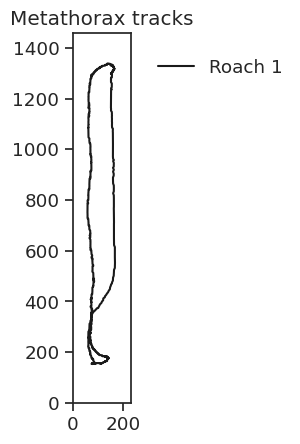

In [ ]:
# Tracks for entire video

sns.set('notebook', 'ticks', font_scale=1.2)

#To track for first x frames, uncomment below two lines below
#for i in range(1): #if multiple mice change 1 to # of mice
#    plt.plot(tracks_matrix[i,0,3,0:1000],tracks_matrix[i,1,3,0:1000]) #Replace 1000 with the number of frames desired

plt.plot(Metathorax_loc[:,0,0],-1* Metathorax_loc[:,1,0] + videoSizeY, 'k',label='Roach 1')
# plt.plot(Metathorax_loc[:,0,1],Metathorax_loc[:,1,1], 'k',label='Roach 2')
#uncomment above to track multiple roaches

plt.legend()
leg = plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=1)

plt.xlim(0,videoSizeX)
#plt.xticks([])

plt.ylim(0,videoSizeY)
#plt.yticks([])
plt.gca().set_aspect('equal', adjustable='box')
plt.title('Metathorax tracks')
plt.gca().set_aspect('equal', adjustable='box')



## Determine time spent in each qudrant and total distance travelled

Total distance traveled (m): 1.6320053956435003
Total time (s): 119.89999999999999

Quartile 1 distance traveled (m): 0.5434939608117456
Time spent in Quartile 1 (s): 44.13333333333333

Quartile 2 distance traveled (m): 0.36216616455011064
Time spent in Quartile 2 (s): 9.733333333333333

Quartile 3 distance traveled (m): 0.3970804048254382
Time spent in Quartile 3 (s): 10.0

Quartile 4 distance traveled (m): 0.44063795861387045
Time spent in Quartile 4 (s): 56.03333333333333



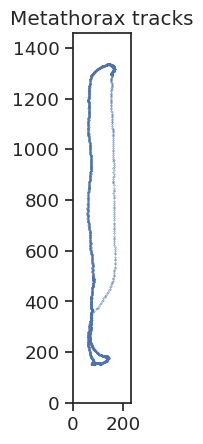

In [ ]:
# Determine time spent and distance traveled in total
xadjust = 0
yadjust = 0
#Create a restricted area of interest by limiting x and y pixels of the video
preBox = pd.DataFrame({'metaX': Metathorax_loc[:, 0,0] + xadjust, 'metaY': (-1*Metathorax_loc[:, 1,0] + yadjust) + videoSizeY }) #convert location tracks to dataframe. Metathorax chosen here.
boxRestrictX=preBox[(preBox['metaX'] >= 0 ) & (preBox['metaX'] <= videoSizeX)] #define location of restricted region of interest along x axis.
boxRestricteXY=preBox[(preBox['metaY'] >= 0) & (preBox['metaY'] <= videoSizeY)] #define location of restricted region of interest along y axis. In this case, it is the whole box

box = boxRestricteXY

#total distance traveled
test=boxRestricteXY.to_numpy() #change back to array for distance calculation
totaldist = 0 #creates dataframe
for i in range(0, len(test)-1):
    totaldist += distance.euclidean(test[i], test[i+1])*(1/ppd)*(1/100) #calculates pixels per distance (in cm) and divides by 100 to obtain distance in meters

######################################################################################
#total time in chamber
totaltime = box.shape[0]*(1/fps) #calculates time based on frames per second
plt.scatter(box['metaX'],box['metaY'], s = 0.1)
plt.xlim(0,videoSizeX)
#plt.xticks([])
plt.ylim(0,videoSizeY)
#plt.yticks([])
plt.gca().set_aspect('equal', adjustable='box')
plt.title('Metathorax tracks')

######################################################################################
# 1st Quartile tracks
ROIX = box[(box['metaX'] >= 0) & (box['metaX'] <= videoSizeX)] # Define region of interest (ROI) along x axis for this quartile
Q1=box[(ROIX['metaY'] >= 0) & (ROIX['metaY'] <= quarterLineBottom)] #Define region of interest along y axis for this quartile

#Quartile 1 distance traveled
Q1values=Q1.to_numpy()
if len(Q1values) > 0:
    # Quartile 2 distance traveled
    Q1Distance = 0
    for i in range(0, len(Q1values)-1):
        Q1Distance += distance.euclidean(Q1values[i], Q1values[i+1])*(1/ppd)*(1/100)

    # time in Q2
    Q1Time = Q1values.shape[0]*(1/fps)
else:
    Q1Distance = 0
    Q1Time = 0


######################################################################################
# 2nd Quartile tracks
ROIX = box[(box['metaX'] >= 0) & (box['metaX'] <= videoSizeX)] # Define region of interest (ROI) along x axis for this quartile
Q2=box[(ROIX['metaY'] >= quarterLineBottom) & (ROIX['metaY'] <= videoSizeY/2)] #Define region of interest along y axis for this quartile

#Quartile 2 distance traveled
Q2values=Q2.to_numpy()
if len(Q2values) > 0:
    # Quartile 2 distance traveled
    Q2Distance = 0
    for i in range(0, len(Q2values)-1):
        Q2Distance += distance.euclidean(Q2values[i], Q2values[i+1])*(1/ppd)*(1/100)

    # time in Q2
    Q2Time = Q2values.shape[0]*(1/fps)
else:
    Q2Distance = 0
    Q2Time = 0


######################################################################################
# 3rd Quartile tracks
ROIX = box[(box['metaX'] >= 0) & (box['metaX'] <= videoSizeX)] # Define region of interest (ROI) along x axis for this quartile
Q3=box[(ROIX['metaY'] >= videoSizeY/2) & (ROIX['metaY'] <= quarterLineTop)] #Define region of interest along y axis for this quartile

#Quartile 3 distance traveled
Q3values=Q3.to_numpy()
if len(Q3values) > 0:
    # Quartile 2 distance traveled
    Q3Distance = 0
    for i in range(0, len(Q3values)-1):
        Q3Distance += distance.euclidean(Q3values[i], Q3values[i+1])*(1/ppd)*(1/100)

    # time in Q2
    Q3Time = Q3values.shape[0]*(1/fps)
else:
    Q3Distance = 0
    Q3Time = 0


######################################################################################
# 4th Quartile tracks
ROIX = box[(box['metaX'] >= 0) & (box['metaX'] <= videoSizeX)] # Define region of interest (ROI) along x axis for this quartile
Q4=box[( ROIX['metaY'] >= quarterLineTop ) & (ROIX['metaY'] <= videoSizeY)] #Define region of interest along y axis for this quartile

#Quartile 4 distance traveled
Q4values=Q4.to_numpy()
if len(Q4values) > 0:
    # Quartile 2 distance traveled
    Q4Distance = 0
    for i in range(0, len(Q4values)-1):
        Q4Distance += distance.euclidean(Q4values[i], Q4values[i+1])*(1/ppd)*(1/100)

    # time in Q2
    Q4Time = Q4values.shape[0]*(1/fps)
else:
    Q4Distance = 0
    Q4Time = 0


print('Total distance traveled (m):', totaldist)
print('Total time (s):', totaltime)
print('')
print('Quartile 1 distance traveled (m):', Q1Distance)
print('Time spent in Quartile 1 (s):', Q1Time) #seconds in defined component of the box
print('')
print('Quartile 2 distance traveled (m):', Q2Distance)
print('Time spent in Quartile 2 (s):', Q2Time) #seconds in defined component of the box
print('')
print('Quartile 3 distance traveled (m):', Q3Distance)
print('Time spent in Quartile 3 (s):', Q3Time) #seconds in defined component of the box
print('')
print('Quartile 4 distance traveled (m):', Q4Distance)
print('Time spent in Quartile 4 (s):', Q4Time) #seconds in defined component of the box
print('')

## Calculate Boundary Crossings

In [ ]:
def count_boundary_crossings(y_coordinates, boundary_positions):
    crossings = [0] * len(boundary_positions)
    previous_position = y_coordinates[0]

    for position in y_coordinates[1:]:
        for i, boundary_y in enumerate(boundary_positions):
            if (previous_position < boundary_y and position >= boundary_y) or \
               (previous_position > boundary_y and position <= boundary_y):
                crossings[i] += 1
        previous_position = position

    return crossings

# Calculate boundary crossings for multiple boundaries for the 'Head' node
anchor_y_coordinates = -1*anchor[:, 1,0] + videoSizeY
boundary_positions = [quarterLineBottom, halfLine, quarterLineTop]  # Specify the y-positions of the boundaries

crossings = count_boundary_crossings(anchor_y_coordinates, boundary_positions)

print("Number of crossings for each boundary:")
for i, boundary_y in enumerate(boundary_positions):
    print(f"Boundary {i + 1} ({boundary_y}): {crossings[i]} crossings.")

Number of crossings for each boundary:
Boundary 1 (435): 2 crossings.
Boundary 2 (755): 2 crossings.
Boundary 3 (1075): 2 crossings.


##Generate heatmap with scatter

<ipython-input-10-105afad76057>:36: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

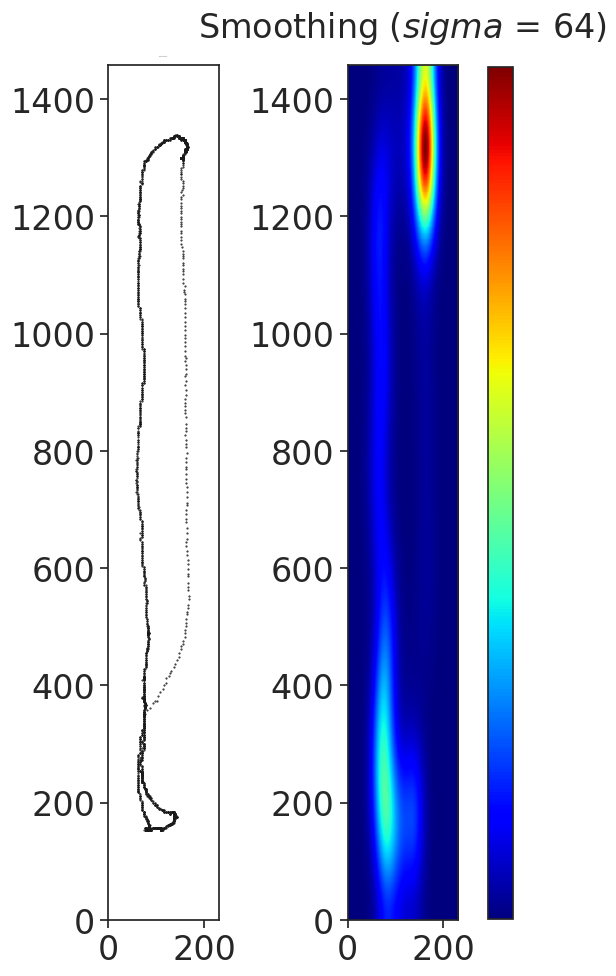

In [ ]:
#make heatmaps
x = box['metaX']
y = box['metaY']

fig, axs = plt.subplots(1, 2,figsize=(5, 10))

def myplot(x, y, s, bins=1000):
    heatmap, xedges, yedges = np.histogram2d(x, y, bins=bins,
                                             range=[[0, videoSizeX], [0, videoSizeY]])
    heatmap = gaussian_filter(heatmap, sigma=s)
    extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]
    return heatmap.T, extent

sigmas = [0, 64]
for ax, s in zip(axs.flatten(), sigmas):
    if s == 0:
        ax.plot(x, y, 'k.', markersize=1)
        ax.set_title("Scatter plot", fontsize = 0)
        ax.set_xlim(0,videoSizeX+xadjust)
        ax.set_ylim(0,videoSizeY)
    else:
        img, extent = myplot(x, y, s)
        im = ax.imshow(img, extent=extent, origin='lower', cmap=cm.jet, aspect='auto', interpolation='none')
        ax.set_xlim(0,videoSizeX)
        ax.set_ylim(0,videoSizeY)
        ax.set_title("Smoothing ($sigma$ = %d)" % s, fontsize = 24, pad = 20)


cbar_ax = fig.add_axes([1, 0.069, 0.05, 0.852])  # [left, bottom, width, height]
cbar = fig.colorbar(im, cax=cbar_ax)
cbar.ax.tick_params(labelsize=0)
cbar.ax.set_yticks([])
for ax in axs:
    ax.tick_params(axis='both', which='major', labelsize=24)

plt.tight_layout()

plt.savefig('fig.svg', format='svg', bbox_inches='tight')
files.download('fig.svg')

plt.show()

## Generate line plot in different colors per chamber

<ipython-input-11-809e64a8fac1>:22: MatplotlibDeprecationWarning: The legendHandles attribute was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use legend_handles instead.
  for handle in leg.legendHandles:


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

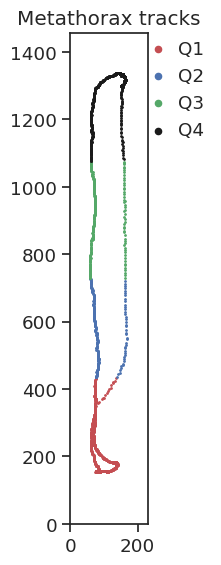

In [ ]:
data = {'Q1': {'color': 'r', 'condition': (box['metaY'] > 0) & (box['metaY'] <= quarterLineBottom)},
        'Q2': {'color': 'b', 'condition': (box['metaY'] > quarterLineBottom) & (box['metaY'] <= videoSizeY/2)},
        'Q3': {'color': 'g', 'condition': (box['metaY'] > videoSizeY/2) & (box['metaY'] <= quarterLineTop)},
        'Q4': {'color': 'k', 'condition': (box['metaY'] > quarterLineTop)}}

s = 1  # Adjust the size as needed

fig, ax = plt.subplots(figsize=(s, s*10))

for label, settings in data.items():
    ax.scatter(box['metaX'][settings['condition']],
               box['metaY'][settings['condition']],
               color=settings['color'], label=label, s=s)

# Set aspect ratio to equal
ax.set_aspect('equal', adjustable='box')

# Set Aesthetics
leg = plt.legend(bbox_to_anchor=(.8, 1), loc='upper left', borderaxespad=0, handletextpad=0.1)

# Set legend marker sizes
for handle in leg.legendHandles:
    handle.set_sizes([s*20])

ax.set_title('Metathorax tracks')
plt.xlim(0, videoSizeX)
plt.ylim(0, videoSizeY)

# Show the plot
# plt.show()

plt.savefig('fig.svg', format='svg', bbox_inches='tight')
files.download('fig.svg')

## Visualize tracks over a video frame

shape is (1438, 224, 3)
pixel at (60,21) [187 198 203]
pixel at (120,10) [202 209 213]


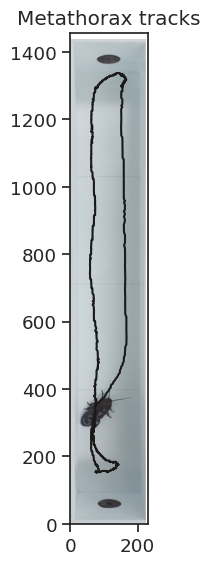

In [ ]:
import pandas as pd
import cv2
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

# Video_FILE = r"/content/drive/Shareddrives/Verpeut_Lab/Vincent Truong/Cockroach/Trench_Behavior /Day 2 /Day_2_0/D2_0_1.mov"
Video_FILE = r"/content/drive/Shareddrives/Verpeut_Lab/Vincent Truong/Cockroach/Trench_Behavior /Day 12 /Day_12_0/D12_0_3.mov"

def get_frames(filename):
    video=cv2.VideoCapture(filename)
    while video.isOpened():
        rete,frame=video.read()
        if rete:
            yield frame
        else:
            break
        video.release()
        yield None

def get_frame(filename,index):
    counter=0
    video=cv2.VideoCapture(filename)
    while video.isOpened():
        rete,frame=video.read()
        if rete:
            if counter==index:
                return frame
            counter +=1
        else:
            break
    video.release()
    return None

frame = get_frame(Video_FILE,1)
print('shape is', frame.shape)
print('pixel at (60,21)',frame[60,21,:])
print('pixel at (120,10)',frame[120,10,:])
img = np.flipud(frame)
img = img/255.0

s = 1  # Adjust the size as needed

plt.figure(figsize=(s, s*10))
plt.plot(box['metaX'], box['metaY'], 'k')
# plt.xticks(np.arange(0, len(box['metaX'])+1, 20),fontsize=10, rotation=45)
# plt.yticks(np.arange(0, len(box['metaY'])+1, 20))
plt.xlim(0,videoSizeX)
plt.ylim(0,videoSizeY)
plt.gca().set_aspect('equal', adjustable='box')
plt.title('Metathorax tracks')
plt.imshow(img)

# plt.savefig('fig.svg', format='svg', bbox_inches='tight')
# files.download('fig.svg')

## Visualize x-y dynamics and velocity

<ipython-input-13-45468bc261b7>:26: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.1, 0.1, 0.1, 1)). The keyword argument will take precedence.
  ax1.plot(Metathorax_loc[:, 0, 0], 'k', label='x', color = '#3279ba')
<ipython-input-13-45468bc261b7>:27: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.1, 0.1, 0.1, 1)). The keyword argument will take precedence.
  ax1.plot(-1*Metathorax_loc[:, 1, 0] + videoSizeY, 'k', label='y', color = '#8C1D40')


Text(0.5, 1.0, 'Velocity')

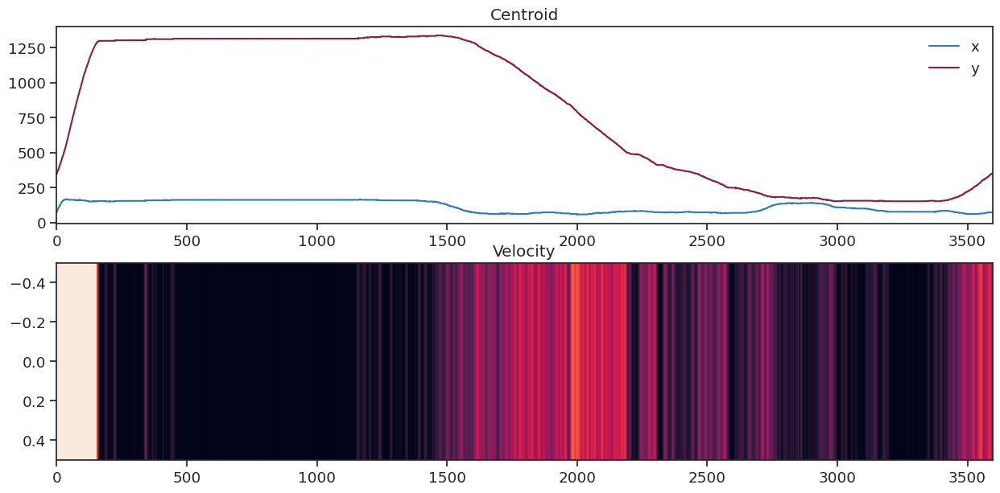

In [ ]:
from scipy.signal import savgol_filter

def smooth_diff(node_loc, win=25, poly=3):
    """
    node_loc is a [frames, 2] array

    win defines the window to smooth over

    poly defines the order of the polynomial
    to fit with

    """
    node_loc_vel = np.zeros_like(node_loc)

    for c in range(node_loc.shape[-1]):
        node_loc_vel[:, c] = savgol_filter(node_loc[:, c], win, poly, deriv=1)

    node_vel = np.linalg.norm(node_loc_vel,axis=1)

    return node_vel

centroid_vel_roach = smooth_diff(Metathorax_loc[:, :, 0])

fig = plt.figure(figsize=(15,7))
ax1 = fig.add_subplot(211)
ax1.plot(Metathorax_loc[:, 0, 0], 'k', label='x', color = '#3279ba')
ax1.plot(-1*Metathorax_loc[:, 1, 0] + videoSizeY, 'k', label='y', color = '#8C1D40')
ax1.legend()
ax1.set_title('Centroid')

ax2 = fig.add_subplot(212, sharex=ax1)
ax2.imshow(centroid_vel_roach[:,np.newaxis].T, aspect='auto', vmin=0, vmax=3)
ax2.set_title('Velocity')

## Visualize node colored by magnitude of speed


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

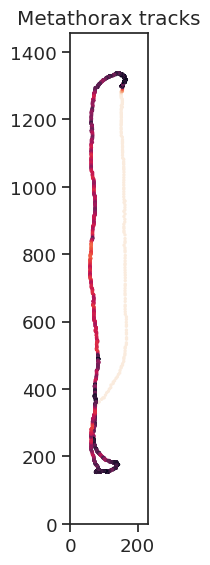

In [ ]:
kp = centroid_vel_roach
vmin = 0
vmax = 3

plt.figure(figsize=(s, s*10))
plt.scatter(Metathorax_loc[:,0,0], videoSizeY - Metathorax_loc[:,1,0], c=kp, s=2, vmin=vmin, vmax=vmax)
plt.xlim(0,videoSizeX)
plt.ylim(0,videoSizeY)
# plt.yticks(np.arange(0, len(box['metaY'])+1, 20))
# plt.xticks(np.arange(0, len(box['metaX'])+1, 20),fontsize=10, rotation=45)
plt.gca().set_aspect('equal', adjustable='box')
plt.title('Metathorax tracks')

plt.savefig('fig.svg', format='svg', bbox_inches='tight')
files.download('fig.svg')

## Behavior Clustering

### Unsupervised clustering  using kmeans

<ipython-input-16-4537add53642>:24: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), fontweight='bold')
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Count for 0 27.7
Count for 1 4.766666666666667
Count for 2 17.866666666666667
Count for 3 69.56666666666666
Count for 4 0.0


<ipython-input-16-4537add53642>:72: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax2.set_xticklabels(ax1.get_xticklabels(), fontweight='bold')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

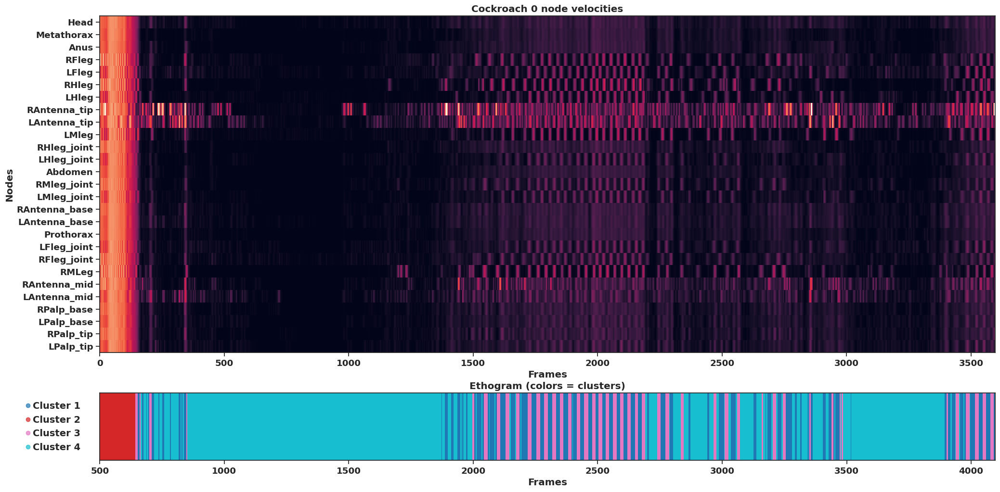

In [ ]:
from sklearn.cluster import KMeans
from mpl_toolkits.axes_grid1 import make_axes_locatable
divider = make_axes_locatable(ax1)
cax = divider.append_axes('right',size='2%',pad=0.05)

def instance_node_velocities(instance_idx):
    node_locations = locations[:, :, :, instance_idx]
    node_velocities = np.zeros((node_locations.shape[0], node_count))

    for n in range(0, node_count):
        node_velocities[:, n] = smooth_diff(node_locations[:, n, :])

    return node_velocities


roach_ID = 0
node_velocities = instance_node_velocities(roach_ID)

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(24, 12), gridspec_kw={'height_ratios': [5, 1]})

ax1.imshow(node_velocities.T, aspect="auto", vmin=0, vmax=10, interpolation="nearest")
ax1.set_xlim(0,frame_count)
ax1.set_xlabel("Frames",fontweight='bold')
ax1.set_xticklabels(ax1.get_xticklabels(), fontweight='bold')
ax1.set_ylabel("Nodes",fontweight='bold')
ax1.set_yticks(np.arange(node_count))
ax1.set_yticklabels(node_names,fontweight='bold')
ax1.set_title(f"Cockroach {roach_ID} node velocities",fontweight='bold')


# ————————————————————— Plot K-Means Clustering ————————————————————————
nstates = 4
km = KMeans(n_clusters=nstates, random_state = 42)
labels = km.fit_predict(node_velocities)
label_df = pd.DataFrame(labels)
# pd.DataFrame(label_df)

X=node_velocities
# velocity_df = pd.DataFrame(X)
# pd.DataFrame(X)
scatter = plt.scatter(X[:, 0], X[:, 1], c=labels, cmap='tab10', marker='o', s=0, alpha=0.7)

# Calculate total number of seconds per cluster
unique, counts = np.unique(labels, return_counts=True)
counts_sorted = np.sort(counts)
behaviors = labels.tolist() #time in a behavior in seconds
print ("Count for 0", behaviors.count(0)/fps)
print ("Count for 1", behaviors.count(1)/fps)
print ("Count for 2", behaviors.count(2)/fps)
print ("Count for 3", behaviors.count(3)/fps)
print ("Count for 4", behaviors.count(4)/fps)
#print ("Count for 5", behaviors.count(5)/fps)
#print ("Count for 6", behaviors.count(6)/fps)
#print ("Count for 7", behaviors.count(7)/fps)
#print ("Count for 8", behaviors.count(8)/fps)
#print ("Count for 9", behaviors.count(9)/fps)
#print ("Count for 10", behaviors.count(10)/fps)

ax2.imshow(labels[None, :], aspect="auto", cmap="tab10", interpolation="nearest")
ax2.set_xlabel("Frames")
ax2.set_yticks([])
ax2.set_title("Ethogram (colors = clusters)",fontweight='bold')
ax2.legend(
    handles=scatter.legend_elements()[0],
    labels=[f'Cluster {i+1}' for i in range(nstates)],
    bbox_to_anchor=(-0.1, 1),  # Adjust the values for the desired position
    loc='upper left',
    handletextpad= -.5,  # Adjust the value for the desired padding
    prop=FontProperties(weight='bold', size=14)
)
ax2.set_xlabel("Frames",fontweight='bold')
ax2.set_xticklabels(ax1.get_xticklabels(), fontweight='bold')

plt.savefig('fig.svg', format='svg', bbox_inches='tight')
files.download('fig.svg')

### Dimensionality Reduction of KMeans Cluster

<ipython-input-17-e1e1badb7d12>:27: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(), fontsize=12, fontweight='bold')


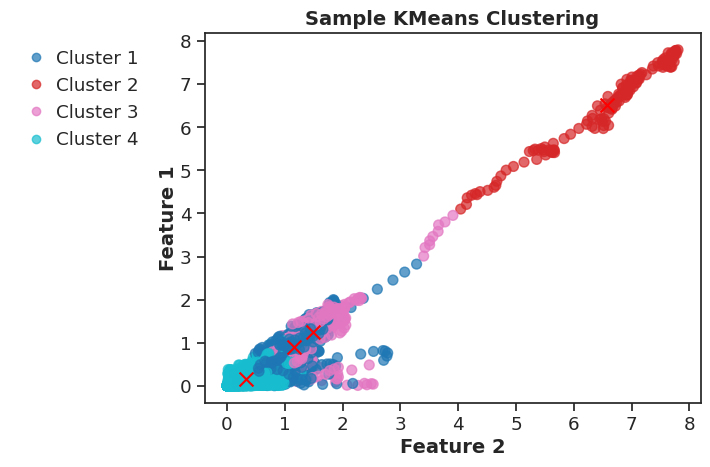

In [ ]:
# Plot cluster centers
scatter = plt.scatter(X[:, 0], X[:, 1], c=labels, cmap='tab10', marker='o', s=50, alpha=0.7)
cluster_centers = km.cluster_centers_
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='red', marker='x', s=100, label='Centroids')

ax = fig.add_subplot(111, projection='3d')
# Add labels and legend
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.title('KMeans Clustering')
plt.legend(handles=scatter.legend_elements()[0],
           labels=[f'Cluster {i+1}' for i in range(nstates)],
           bbox_to_anchor=(-0.1, 1),  # Adjust the values for the desired position
           loc='upper right',
           handletextpad=0.1  # Adjust the value for the desired padding
)
s=1

ax.spines['right'].set_visible(False)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')

ax.yaxis.grid(False)
# Adjust ticks
ax.set_yticklabels(ax.get_yticks(), fontsize=12, fontweight='bold')
ax.tick_params(pad=4*s, labelsize=6*s)

# Adjust labels and titles
plt.ylabel('Feature 1', fontsize=14*s, labelpad=1*s, fontweight='bold')
plt.xlabel('Feature 2', fontsize=14*s, labelpad=3*s, fontweight='bold')
plt.title('Sample KMeans Clustering', fontsize=14*s, fontweight='bold')

plt.show()

# plt.savefig('fig.svg', format='svg', bbox_inches='tight')
# files.download('fig.svg')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

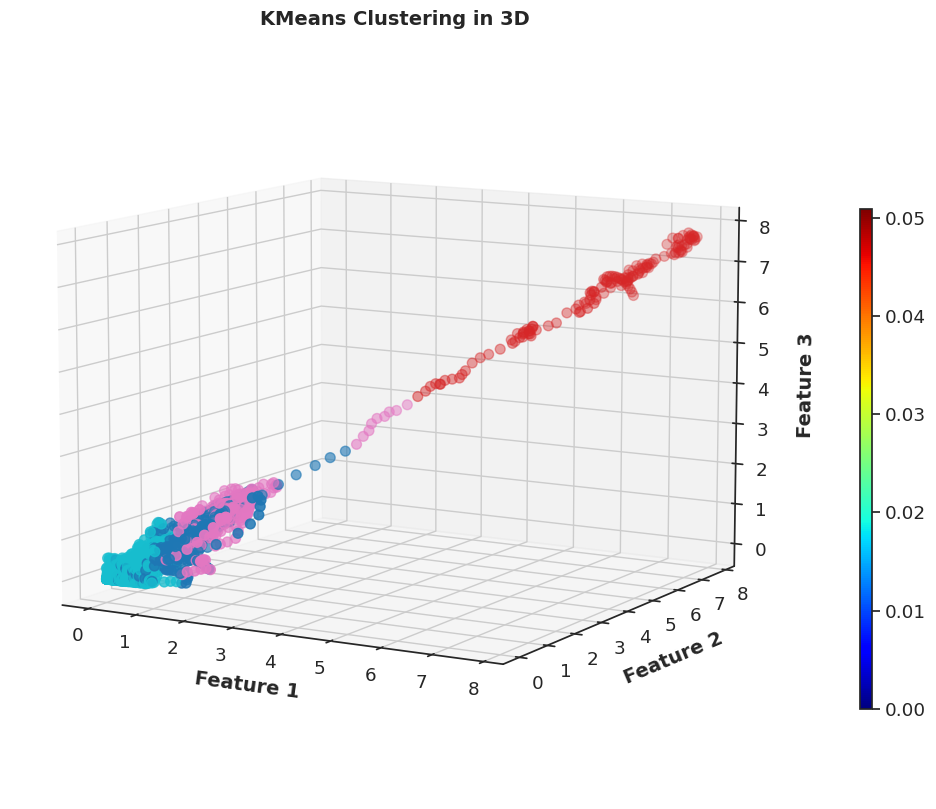

In [ ]:
# Create a 3D scatter plot
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot of data points colored by cluster assignments
scatter = ax.scatter(X[:, 0], X[:, 1], X[:, 2], c=labels, cmap='tab10', s=50)

# Add labels and legend
ax.set_xlabel('Feature 1', fontsize=14, fontweight='bold', labelpad = 10)
ax.set_ylabel('Feature 2', fontsize=14, fontweight='bold', labelpad = 10)
ax.set_zlabel('Feature 3', fontsize=14, fontweight='bold', labelpad = 10)
ax.set_title('KMeans Clustering in 3D', fontsize=14, fontweight='bold', pad = 0)
ax.view_init(elev=10) #Adjust height and viewing angle
cbar_ax = fig.add_axes([.9, 0.2, 0.01, 0.5])  # [left, bottom, width, height]
cbar = fig.colorbar(im, cax=cbar_ax)

plt.savefig('fig.svg', format='svg', bbox_inches='tight')
files.download('fig.svg')

plt.show()

### Dimensionality Reduction with PCA

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

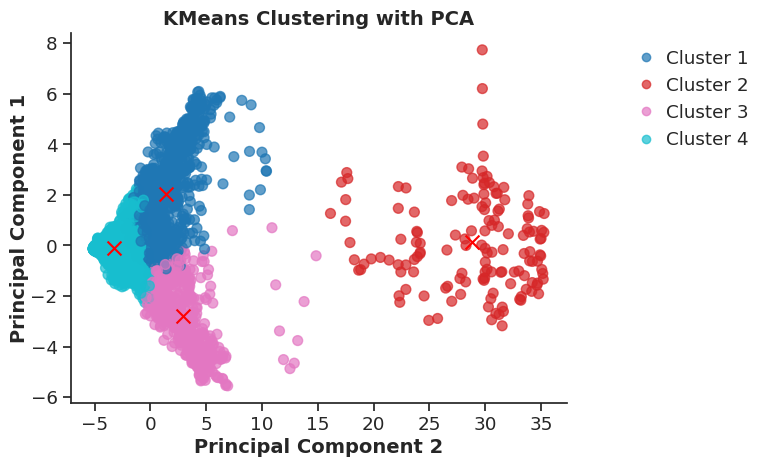

In [ ]:
from sklearn.decomposition import PCA

# Apply PCA for dimensionality reduction
n_components = 2  # Set the desired number of components
pca = PCA(n_components=n_components)
X_pca = pca.fit_transform(X)

# Scatter plot of PCA components
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=labels, cmap='tab10', marker='o', s=50, alpha=0.7)

# Plot cluster centers in the PCA space
cluster_centers_pca = pca.transform(km.cluster_centers_)
plt.scatter(cluster_centers_pca[:, 0], cluster_centers_pca[:, 1], c='red', marker='x', s=100, label='Centroids')

# Add labels and legend
plt.ylabel('Principal Component 1', fontsize=14*s, labelpad=1*s, fontweight='bold')
plt.xlabel('Principal Component 2', fontsize=14*s, labelpad=3*s, fontweight='bold')
plt.title('KMeans Clustering with PCA', fontsize=14*s, fontweight='bold')

plt.legend(handles=scatter.legend_elements()[0],
           labels=[f'Cluster {i+1}' for i in range(nstates)],
           bbox_to_anchor=(1.4, 1),  # Adjust the values for the desired position
           loc='upper right',
           handletextpad=0.1  # Adjust the value for the desired padding
)

sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)

# plt.show()

# plt.savefig('fig.svg', format='svg', bbox_inches='tight')
# files.download('fig.svg')

### Dimensionality Reduction with UMAPS

,UMAP_Component_1,UMAP_Component_2
0,9.578208,-2.515614
1,9.583256,-2.523787
2,9.576496,-2.470873
3,9.577642,-2.482062
4,9.649664,-2.485637
...,...,...
3592,13.222733,9.568512
3593,11.118464,7.204883
3594,11.262649,6.756572
3595,11.422576,3.288263


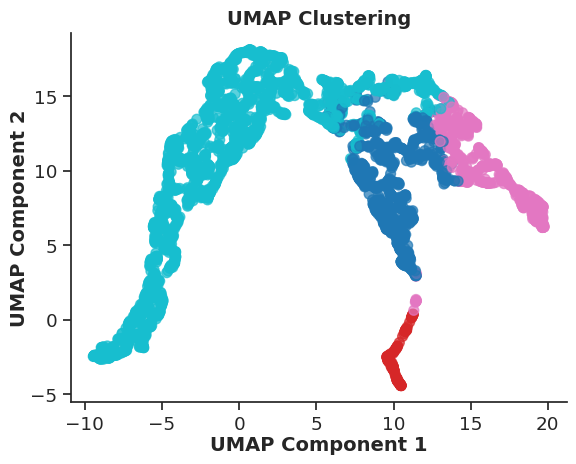

In [ ]:
umap_model = umap.UMAP(n_components=2)  # You can specify the number of components
X_umap = umap_model.fit_transform(X_pca)
# X_umap = umap_model.fit_transform(X)
s = 1
embedding_df = pd.DataFrame(X_umap, columns=['UMAP_Component_1', 'UMAP_Component_2'])
plt.scatter(X_umap[:, 0], X_umap[:, 1], c=labels, cmap='tab10', marker='o', s=50, alpha=0.7)
plt.title('UMAP Clustering', fontsize=14*s, fontweight='bold')
plt.xlabel('UMAP Component 1', fontsize=14*s, labelpad=1*s, fontweight='bold')
plt.ylabel('UMAP Component 2', fontsize=14*s, labelpad=1*s, fontweight='bold')

sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)

# plt.savefig('fig.svg', format='svg', bbox_inches='tight')
# files.download('fig.svg')

pd.DataFrame(embedding_df)
# plt.show()

## Calculate Average Velolcities of Nodes


In [ ]:
# Set up mega sheet for batch data collection from multiple h5 files
# This resets the mega sheet if ran; thus, only run this cell ONCE to initialize
allRoaches = pd.DataFrame()
allVelocities = pd.DataFrame()

In [ ]:
# Converts pixel per frame to cm/s
def pixel_to_cm_per_s(pixel_value):
    if isinstance(pixel_value, (int, float, np.number)):
        conversion_factor = fps / ppd  # fps and ppd defined earlier in the code
        return pixel_value * conversion_factor
    else:
        return pixel_value

# Set the path to the directory containing your .h5 files
h5_files_directory = '/content/drive/Shareddrives/Verpeut_Lab/Vincent Truong/Cockroach/Predictions/Batch 1/'

# Get a list of all .h5 files in the directory
h5_files = [f for f in os.listdir(h5_files_directory) if f.endswith('.h5')]

# Initialize an empty DataFrame to store results
result_df = pd.DataFrame()
nodeAdded = False

# Loop over each .h5 file
for h5_file in h5_files:
    # Set the full file path
    file_path = os.path.join(h5_files_directory, h5_file)

    with h5py.File(file_path, "r") as f:
        # print(f)
        filename = file_path
        locations = f["tracks"][:].T
        node_names = [n.decode() for n in f["node_names"][:]]
        locations = fill_missing(locations)

        node_velocities = instance_node_velocities(roach_ID)
        # Ensure all arrays have the same length
        min_length = min(len(node_velocities), len(locations))
        node_velocities = node_velocities[:min_length]
        temp =  pd.DataFrame(node_velocities)
        allVelocities = pd.concat([allVelocities, temp], axis=0, ignore_index = True)
        average_velocity = pd.DataFrame(node_velocities).mean().transpose()

        # Create a DataFrame to store the results for this file
        file_result_df = pd.DataFrame({'Node': node_names,
                                       'AverageVelocity': node_velocities.mean(axis=0)})

        # Add a new column for each video file
        file_result_df[h5_file.replace(".predictions", "").replace(".h5", "").replace(".mp4", "")] = node_velocities.mean(axis=0)

        # Drop the 'AverageVelocity' column
        if nodeAdded == False :
          file_result_df = file_result_df.drop(columns=['AverageVelocity'])
          nodeAdded = True
        else:
          file_result_df = file_result_df.drop(columns=['AverageVelocity', 'Node'])

        # Apply the conversion function to the DataFrame
        file_result_df = file_result_df.applymap(pixel_to_cm_per_s)

    # Concatenate the file-specific results to the overall results
    result_df = pd.concat([result_df, file_result_df], axis=1)


video_names = result_df.columns.tolist()
vidoes = pd.DataFrame([video_names], columns=result_df.columns)
result_df = pd.concat([vidoes, result_df], ignore_index=True)
result_df = result_df.transpose()

# Display the final result DataFrame
pd.DataFrame(result_df)
# pd.DataFrame(allVelocities)

In [ ]:
# Add whichever batch analyzed above to the master dataframe; run this cell for after analyzing one batch
# allRoaches = pd.concat([allRoaches, result_df])
pd.DataFrame.from_records(allRoaches)
# pd.DataFrame.from_records(allVelocities)

# Uncomment below to write your master sheet to an existing google sheets
# workbook = gc.open('Roach Data using SLEAP')
# worksheet = workbook.worksheet('Raw Velocity Data')
# set_with_dataframe(worksheet, allRoaches, row=1, col=1)

In [ ]:
# Show master batch sheet
# ONLY RUN THIS CELL AFTER ADDING ALL batches to the master batch sheet
allRoaches.columns = allRoaches.iloc[0]
allRoaches = allRoaches[allRoaches.Node != 'Node']

# Custom sorting function
def custom_sort(node):
    if node.startswith('D'):
        day, group, subject = node.split('_')
        return ('D', int(day[1:]), group, int(subject))
    elif node.startswith('IMG'):
        _, number, _ = node.split('_')
        return ('IMG', int(number))

# Apply the custom sorting function to the 'Node' column
allRoaches['sort_key'] = allRoaches['Node'].apply(custom_sort)
allRoaches_sorted = allRoaches.sort_values(by='sort_key').drop(columns='sort_key').reset_index(drop=True)

pd.DataFrame.from_records(allRoaches_sorted)

In [ ]:
# Find average velocity for a single roach
df_velocity = pd.DataFrame(node_velocities)
average_velocity = df_velocity.mean().transpose()

video_file_name = os.path.basename(file)
video_file_name, _ = os.path.splitext(video_file_name)
video_file_name = video_file_name.replace(".predictions", "").replace(".h5", "").replace(".mp4", "")

# Display the average velocity as a DataFrame
pd.DataFrame(average_velocity, columns=[video_file_name])

## Overlay tracks on video

shape is (1438, 224, 3)
pixel at (60,21) [189 200 203]
pixel at (120,10) [199 206 209]


<ipython-input-15-dae115189285>:72: MatplotlibDeprecationWarning: The legendHandles attribute was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use legend_handles instead.
  for handle in leg.legendHandles:


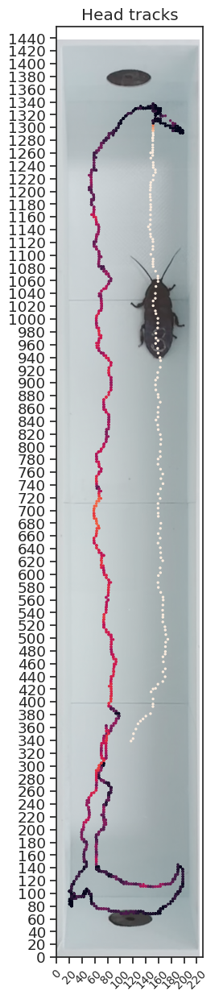

In [ ]:
import pandas as pd
import cv2
import matplotlib.pyplot as plt

# Video_FILE = r"/content/drive/Shareddrives/Verpeut_Lab/Vincent Truong/Cockroach/Trench_Behavior /Day 12 /Day_2_0/D2_0_1.mov"
Video_FILE = r"/content/drive/Shareddrives/Verpeut_Lab/Vincent Truong/Cockroach/Trench_Behavior /Day 12 /Day_12_0/D12_0_3.mov"

def get_frames(filename):
    video=cv2.VideoCapture(filename)
    while video.isOpened():
        rete,frame=video.read()
        if rete:
            yield frame
        else:
            break
        video.release()
        yield None

def get_frame(filename,index):
    counter=0
    video=cv2.VideoCapture(filename)
    while video.isOpened():
        rete,frame=video.read()
        if rete:
            if counter==index:
                return frame
            counter +=1
        else:
            break
    video.release()
    return None

frame = get_frame(Video_FILE,100)
print('shape is', frame.shape)
print('pixel at (60,21)',frame[60,21,:])
print('pixel at (120,10)',frame[120,10,:])


img = np.flipud(frame)
img = img/255.0
positionAdjust = -50
plt.figure(figsize=(15,15))

# ————— Uncomment below to show tracks (you can add to the y axix to account for video positioning) —————
# plt.plot(box['metaX'],box['metaY'], 'k')

# ————— Uncomment below to show tracks color-coded for each quadrant (you can add to the y axid to account for video positioning) —————
# data = {'Q1': {'color': 'r', 'condition': (box['metaY'] > 0) & (box['metaY'] <= quarterLineBottom)},
#         'Q2': {'color': 'b', 'condition': (box['metaY'] > quarterLineBottom) & (box['metaY'] <= videoSizeY/2)},
#         'Q3': {'color': 'g', 'condition': (box['metaY'] > videoSizeY/2) & (box['metaY'] <= quarterLineTop)},
#         'Q4': {'color': 'k', 'condition': (box['metaY'] > quarterLineTop)}}

# s = 1  # Adjust the size as needed
# fig, ax = plt.subplots(figsize=(s*15, s*15))
# for label, settings in data.items():
#     ax.scatter(box['metaX'][settings['condition']],
#                box['metaY'][settings['condition']],
#                color=settings['color'], label=label, s=s)


# ————— Uncomment below to show tracks as velocity heat map (you can add to the y axid to account for video positioning) —————
plt.scatter(anchor[:,0,0], videoSizeY - anchor[:,1,0] + positionAdjust, c=kp, s=2, vmin=vmin, vmax=vmax)

# ————— Do not uncomment below; this controld figure aesthetics —————
# Set aspect ratio to equal
ax.set_aspect('equal', adjustable='box')

# Set Aesthetics
leg = plt.legend(bbox_to_anchor=(1, 1), loc='upper left', borderaxespad=0, handletextpad=0.1)

# Set legend marker sizes
for handle in leg.legendHandles:
    handle.set_sizes([s*10])

ax.set_title('Metathorax tracks')
plt.xlim(0, videoSizeX)
plt.ylim(0, videoSizeY)

plt.xticks(np.arange(0, len(anchor[:,0,0])+1, 20),fontsize=10, rotation=45)
plt.yticks(np.arange(0, len(anchor[:,0,0])+1, 20))
plt.xlim(0,videoSizeX)

plt.ylim(0,videoSizeY)
plt.gca().set_aspect('equal', adjustable='box')
plt.title(anchorName + ' tracks')
plt.imshow(img)

# plt.savefig('fig.svg', format='svg', bbox_inches='tight')
# files.download('fig.svg')

## Create GIF of Instances

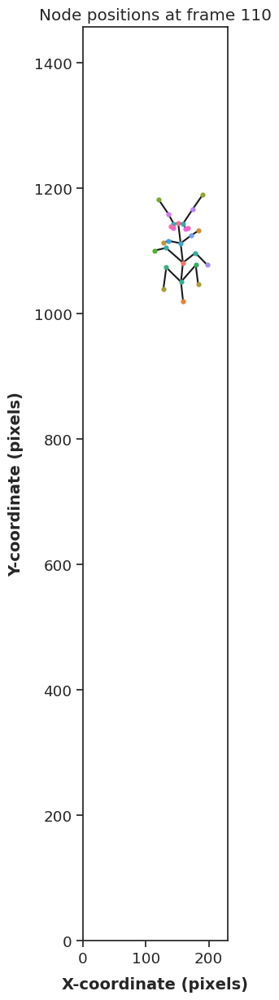

In [ ]:
# Define the frame number you want to plot (change this to your desired frame)
frame_number = 110

# Create a color map for differentiating between multiple animals
colors = ['b', 'g', 'r']

seaborn_palette = sns.color_palette("husl", n_colors=len(node_names))
node_colors = dict(zip(node_names, seaborn_palette))

edges = [
        ['Metathorax', 'Abdomen'],
        ['Abdomen' , 'Anus'],
        ['Metathorax' , 'RMleg_joint'],
        ['Metathorax' , 'LMleg_joint'],
        ['LMleg_joint' , 'LMleg'],
        ['Abdomen' , 'RHleg_joint'],
        ['Abdomen' , 'LHleg_joint'],
        ['RHleg_joint' , 'RHleg'],
        ['LHleg_joint' , 'LHleg'],
        ['Head' , 'RAntenna_base'],
        ['Head' , 'LAntenna_base'],
        ['Head' , 'Prothorax'],
        ['Prothorax' , 'Metathorax'],
        ['Prothorax' , 'LFleg_joint'],
        ['Prothorax' , 'RFleg_joint'],
        ['LFleg_joint' , 'LFleg'],
        ['RFleg_joint' , 'RFleg'],
        ['RMLeg' , 'RMleg_joint'],
        ['RAntenna_base' , 'RAntenna_mid'],
        ['LAntenna_base' , 'LAntenna_mid'],
        ['RAntenna_mid' , 'RAntenna_tip'],
        ['LAntenna_mid' , 'LAntenna_tip'],
        ['RPalp_base' , 'RPalp_tip'],
        ['LPalp_tip' , 'LPalp_base'],
        ['RPalp_base' , 'RAntenna_base'],
        ['LPalp_base' , 'LAntenna_base']
]

# Plot all nodes for all animals on a single plot
plt.figure(figsize=(videoSizeX/100, videoSizeY/100))

for node_index, node_name in enumerate(node_names):
    plt.title(f'Node positions at frame {frame_number}')
    plt.xlabel('X-coordinate (pixels)',fontsize=14,  labelpad = 9, fontweight='bold')
    plt.ylabel('Y-coordinate (pixels)',fontsize=14,  labelpad = 9, fontweight='bold')

    for i in range(1):  # Loop through each animal
        x = locations[frame_number, node_index, 0, i]
        y = locations[frame_number, node_index, 1, i]
        # Get the color from the dictionary based on the node name
        node_color = node_colors.get(node_name, 'black')  # Default to black if not found
        plt.scatter(x, videoSizeY- y, label=f'{node_name} - Mouse {i + 1}', color=node_color, zorder=2, s=12)

# Connect points using edge names
for edge in edges:
    node1_index = node_names.index(edge[0])
    node2_index = node_names.index(edge[1])

    for i in range(1):  # Loop through each animal
        x1 = locations[frame_number, node1_index, 0, i]
        y1 = locations[frame_number, node1_index, 1, i]
        x2 = locations[frame_number, node2_index, 0, i]
        y2 = locations[frame_number, node2_index, 1, i]

        plt.plot([x1, x2], [ videoSizeY- y1,  videoSizeY- y2], color='k', zorder=1)

# Add legend
plt.legend('')
plt.xlim(0, videoSizeX)
plt.ylim(0, videoSizeY)
plt.grid(False)

# Show the plot

plt.show()

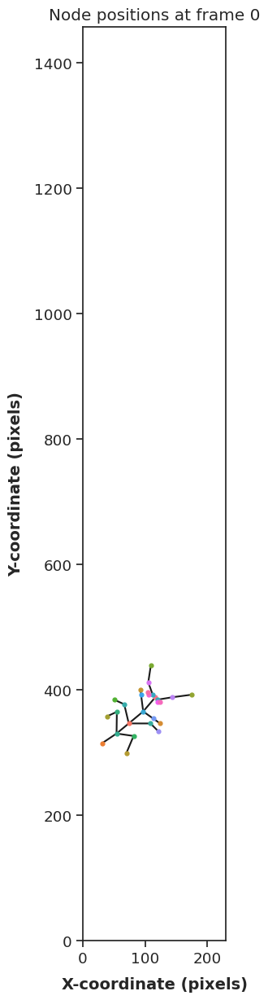

In [ ]:
#CREATE MOVIE!

import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Define the frame numbers you want to plot (change this to your desired frames)
frame_numbers = range(0, 10)  # for example, frames 100 to 150

# Create a function to update the plot for each frame
def update(frame_number):
    plt.clf()  # clear the current plot

    # Plot all nodes for all three animals on a single plot
    for node_index, node_name in enumerate(node_names):
        plt.title(f'Node positions at frame {frame_number}')
        plt.xlabel('X-coordinate (pixels)',fontsize=14,  labelpad = 9, fontweight='bold')
        plt.ylabel('Y-coordinate (pixels)',fontsize=14,  labelpad = 9, fontweight='bold')

        for i in range(1):  # Loop through each animal
            x = locations[frame_number, node_index, 0, i]
            y = locations[frame_number, node_index, 1, i]
            # Get the color from the dictionary based on the node name
            node_color = node_colors.get(node_name, 'black')  # Default to black if not found
            plt.scatter(x,  videoSizeY-y, label=f'{node_name} - Mouse {i + 1}', color=node_color, zorder=2, s=12)


    # Connect points using edge names
    for edge in edges:
        node1_index = node_names.index(edge[0])
        node2_index = node_names.index(edge[1])

        for i in range(1):  # Loop through each animal
            x1 = locations[frame_number, node1_index, 0, i]
            y1 = locations[frame_number, node1_index, 1, i]
            x2 = locations[frame_number, node2_index, 0, i]
            y2 = locations[frame_number, node2_index, 1, i]

            plt.plot([x1, x2], [ videoSizeY-y1,  videoSizeY-y2], color='k', zorder=1)

        plt.xlim(0, videoSizeX)
        plt.ylim(0, videoSizeY)

    plt.grid(False)

# Create the animation
ani = FuncAnimation(plt.figure(figsize=(videoSizeX/100, videoSizeY/100)), update, frames=frame_numbers, interval=100)

file = '/content/drive/Shareddrives/Verpeut_Lab/Vincent Truong/Cockroach/models/'
# ani.save(file + 'animation.mp4', writer='ffmpeg')

# Display the animation
from IPython.display import HTML
HTML(ani.to_jshtml())


## Create GIF of Instances over video

shape is (1438, 224, 3)
pixel at (60,21) [189 200 203]
pixel at (120,10) [199 206 209]


<Figure size 1500x1500 with 0 Axes>

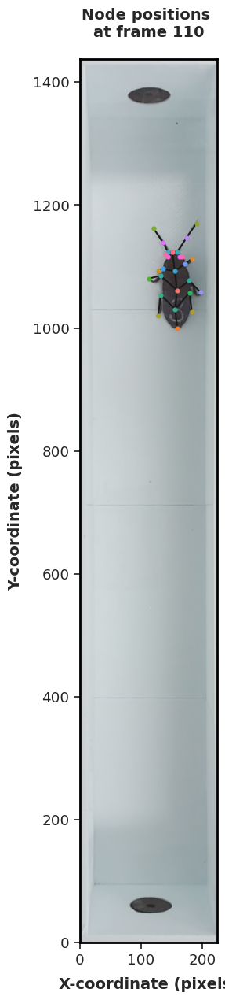

In [ ]:
# Define the frame number you want to plot (change this to your desired frame)
frame_number = 110

# Create a color map for differentiating between multiple animals
colors = ['b', 'g', 'r']

seaborn_palette = sns.color_palette("husl", n_colors=len(node_names))
node_colors = dict(zip(node_names, seaborn_palette))
yadjust = 20
xadjust = 5
edges = [
        ['Metathorax', 'Abdomen'],
        ['Abdomen' , 'Anus'],
        ['Metathorax' , 'RMleg_joint'],
        ['Metathorax' , 'LMleg_joint'],
        ['LMleg_joint' , 'LMleg'],
        ['Abdomen' , 'RHleg_joint'],
        ['Abdomen' , 'LHleg_joint'],
        ['RHleg_joint' , 'RHleg'],
        ['LHleg_joint' , 'LHleg'],
        ['Head' , 'RAntenna_base'],
        ['Head' , 'LAntenna_base'],
        ['Head' , 'Prothorax'],
        ['Prothorax' , 'Metathorax'],
        ['Prothorax' , 'LFleg_joint'],
        ['Prothorax' , 'RFleg_joint'],
        ['LFleg_joint' , 'LFleg'],
        ['RFleg_joint' , 'RFleg'],
        ['RMLeg' , 'RMleg_joint'],
        ['RAntenna_base' , 'RAntenna_mid'],
        ['LAntenna_base' , 'LAntenna_mid'],
        ['RAntenna_mid' , 'RAntenna_tip'],
        ['LAntenna_mid' , 'LAntenna_tip'],
        ['RPalp_base' , 'RPalp_tip'],
        ['LPalp_tip' , 'LPalp_base'],
        ['RPalp_base' , 'RAntenna_base'],
        ['LPalp_base' , 'LAntenna_base']
]


frame = get_frame(Video_FILE,frame_number)
print('shape is', frame.shape)
print('pixel at (60,21)',frame[60,21,:])
print('pixel at (120,10)',frame[120,10,:])


img = np.flipud(frame)
img = img/255.0
positionAdjust = -50
plt.figure(figsize=(15,15))

# Plot all nodes for all animals on a single plot
plt.figure(figsize=(videoSizeX/100, videoSizeY/100))

for node_index, node_name in enumerate(node_names):
    title = f'Node positions \nat frame {frame_number}'
    plt.title(title, fontsize=14, pad=20, fontweight='bold')  # Adjust the pad value as needed
    plt.xlabel('X-coordinate (pixels)',fontsize=14,  labelpad = 9, fontweight='bold')
    plt.ylabel('Y-coordinate (pixels)',fontsize=14,  labelpad = 9, fontweight='bold')

    for i in range(1):  # Loop through each animal
        x = locations[frame_number, node_index, 0, i]
        y = locations[frame_number, node_index, 1, i] + yadjust
        # Get the color from the dictionary based on the node name
        node_color = node_colors.get(node_name, 'black')  # Default to black if not found
        plt.scatter(x, videoSizeY- y, label=f'{node_name} - Mouse {i + 1}', color=node_color, zorder=2, s=12)

# Connect points using edge names
for edge in edges:
    node1_index = node_names.index(edge[0])
    node2_index = node_names.index(edge[1])

    for i in range(1):  # Loop through each animal
        x1 = locations[frame_number, node1_index, 0, i]
        y1 = locations[frame_number, node1_index, 1, i] + yadjust
        x2 = locations[frame_number, node2_index, 0, i]
        y2 = locations[frame_number, node2_index, 1, i] + yadjust

        plt.plot([x1, x2], [ videoSizeY- y1,  videoSizeY- y2], color='k', zorder=1)

# Add legend
plt.legend('')
plt.xlim(0, videoSizeX - xadjust)
plt.ylim(0, videoSizeY - yadjust)
plt.grid(False)
# Set spines
ax = plt.gca()
ax.spines['top'].set_linewidth(2)
ax.spines['top'].set_color('black')
ax.spines['right'].set_linewidth(2)
ax.spines['right'].set_color('black')
ax.spines['bottom'].set_linewidth(2)
ax.spines['left'].set_linewidth(2)
ax.spines['bottom'].set_color('black')
ax.spines['left'].set_color('black')
plt.imshow(img)

Working on frame # 1
Working on frame # 1
Working on frame # 2
Working on frame # 3
Working on frame # 4
Working on frame # 5
Working on frame # 6
Working on frame # 7
Working on frame # 8
Working on frame # 9
Working on frame # 10
Working on frame # 11
Working on frame # 12
Working on frame # 13
Working on frame # 14
Working on frame # 15
Working on frame # 16
Working on frame # 17
Working on frame # 18
Working on frame # 19
Working on frame # 20
Working on frame # 21
Working on frame # 22
Working on frame # 23
Working on frame # 24
Working on frame # 25
Working on frame # 26
Working on frame # 27
Working on frame # 28
Working on frame # 29
Working on frame # 30
Working on frame # 31
Working on frame # 32
Working on frame # 33
Working on frame # 34
Working on frame # 35
Working on frame # 36
Working on frame # 37
Working on frame # 38
Working on frame # 39
Working on frame # 40
Working on frame # 41
Working on frame # 42
Working on frame # 43
Working on frame # 44
Working on frame # 4

Working on frame # 74
Working on frame # 75
Working on frame # 76
Working on frame # 77
Working on frame # 78
Working on frame # 79
Working on frame # 80
Working on frame # 81
Working on frame # 82
Working on frame # 83
Working on frame # 84
Working on frame # 85
Working on frame # 86
Working on frame # 87
Working on frame # 88
Working on frame # 89
Working on frame # 90
Working on frame # 91
Working on frame # 92
Working on frame # 93
Working on frame # 94
Working on frame # 95
Working on frame # 96
Working on frame # 97
Working on frame # 98
Working on frame # 99
Working on frame # 100
Working on frame # 101
Working on frame # 102
Working on frame # 103
Working on frame # 104
Working on frame # 105
Working on frame # 106
Working on frame # 107
Working on frame # 108
Working on frame # 109
Working on frame # 110
Working on frame # 111
Working on frame # 112
Working on frame # 113
Working on frame # 114
Working on frame # 115
Working on frame # 116
Working on frame # 117
Working on fra

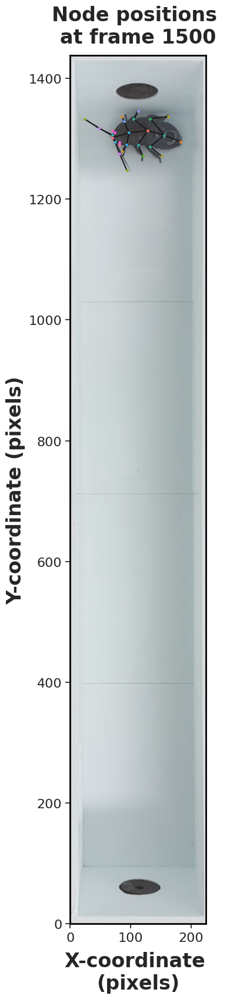

In [ ]:
#CREATE MOVIE!

import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Define the frame numbers you want to plot (change this to your desired frames)
frame_numbers = range(0, 1500)  # for example, frames 100 to 150
# Create a function to update the plot for each frame
def update(frame_number):
    plt.clf()  # clear the current plot
    print("Working on frame # " + str(frame_number + 1))
    # Load the video frame
    frame = get_frame(Video_FILE, frame_number)
    frame = np.flipud(frame)
    # Plot the video frame
    plt.imshow(frame)

    # Plot the nodes for each animal
    for node_index, node_name in enumerate(node_names):
        for i in range(1):  # Loop through each animal
            x = locations[frame_number, node_index, 0, i]
            y = locations[frame_number, node_index, 1, i] + yadjust
            node_color = node_colors.get(node_name, 'black')  # Default to black if not found
            plt.scatter(x, videoSizeY - y, label=f'{node_name} - Mouse {i + 1}', color=node_color, zorder=2, s=6)

    # Connect points using edge names
    for edge in edges:
        node1_index = node_names.index(edge[0])
        node2_index = node_names.index(edge[1])

        for i in range(1):  # Loop through each animal
            x1 = locations[frame_number, node1_index, 0, i]
            y1 = locations[frame_number, node1_index, 1, i] + yadjust
            x2 = locations[frame_number, node2_index, 0, i]
            y2 = locations[frame_number, node2_index, 1, i] + yadjust

            plt.plot([x1, x2], [videoSizeY - y1, videoSizeY - y2], color='k', zorder=1)

    # Set plot labels and limits
    title = f'Node positions \nat frame {frame_number + 1}'
    plt.title(title, fontsize=24, pad=15, fontweight='bold')  # Adjust the pad value as needed
    plt.xlabel('X-coordinate \n(pixels)', fontsize=24, labelpad=9, fontweight='bold')
    plt.ylabel('Y-coordinate (pixels)', fontsize=24, labelpad=4, fontweight='bold')
    plt.xlim(0, videoSizeX - xadjust)
    plt.ylim(0, videoSizeY - yadjust)

    # Make spines thicker
    ax = plt.gca()
    ax.spines['top'].set_linewidth(2)
    ax.spines['top'].set_color('black')
    ax.spines['right'].set_linewidth(2)
    ax.spines['right'].set_color('black')
    ax.spines['bottom'].set_linewidth(2)
    ax.spines['left'].set_linewidth(2)
    ax.spines['bottom'].set_color('black')
    ax.spines['left'].set_color('black')
    ax.tick_params(pad = 4, labelsize = 16)
    plt.grid(False)

# Create the animation
ani = FuncAnimation(plt.figure(figsize=(videoSizeX/50-.1, videoSizeY/50-10)), update, frames=frame_numbers, interval=100)

file = '/content/drive/Shareddrives/Verpeut_Lab/Vincent Truong/Cockroach/models/'
ani.save(file + 'animation3.mp4', writer='ffmpeg'

# Display the animation
from IPython.display import HTML
HTML(ani.to_jshtml())


# **4.** Plot Figures
We plot figures based on data obtained from a google sheet file

In [ ]:
from google.colab import auth
auth.authenticate_user()

import gspread
import matplotlib.ticker as plticker
from google.auth import default
creds, _ = default()

gc = gspread.authorize(creds)

##🟣 Statistical Tests

### Set up datasheet

In [ ]:
#—————————————————————————————— Set up your data ——————————————————————————————
sheet = gc.open('Roach Data using SLEAP').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(axis=0, how='all').dropna(axis=1, how='all')
df1 = df[df.Group.notna()]
# df1 = df1[df1.Day != 1]
# df1 = df1[df1.Day != 2]
# df1 = df1[df1.Day != 3]
# df1 = df1[df1.Day != 4]
# df1 = df1[df1.Day != 5]
# df1 = df1[df1.Day != 6]
# df1 = df1[df1.Day != 7]
# df1 = df1[df1.Day != 8]
# df1 = df1[df1.Day != 9]
# df1 = df1[df1.Day != 10]
# df1 = df1[df1.Day != 11]
# df1 = df1[df1.Day != 12]
# df1 = df1[df1.Day != 13]
# df1 = df1[df1.Day != 14]
# df1 = df1[df1.Quadrant == 'Q4']
# df1 = df1[df1.Day ==14]
df1 = df1[df1.Group == 'Air']  # Air  Water  Water + Nicotine
# df1 = df1[df1.ScoreType == 'Hand Scored']
df1 = df1[df1.ScoreType == 'SLEAP']
df1 = df1[df1.Time.notna()]

df1['Time'] = pd.to_numeric(df1['Time'], errors='coerce')
df1['Distance'] = pd.to_numeric(df1['Distance'], errors='coerce')
df1['Group'] = df1['Group'].astype(str)
df1['Subject'] = df1['Subject'].astype(str)
pd.DataFrame.from_records(df1)


,Day,Group,ScoreType,Grouping,Quadrant,Time,Distance,Subject,Unnamed: 8
239,1.0,Air,SLEAP,SLEAP - Air,Q1,27.666667,0.454523,Air_1,NaN
240,1.0,Air,SLEAP,SLEAP - Air,Q1,57.266667,2.162045,Air_2,NaN
241,1.0,Air,SLEAP,SLEAP - Air,Q1,95.700000,4.670758,Air_3,NaN
242,1.0,Air,SLEAP,SLEAP - Air,Q1,72.333333,1.692059,Air_4,NaN
243,1.0,Air,SLEAP,SLEAP - Air,Q1,58.466667,0.735194,Air_5,NaN
...,...,...,...,...,...,...,...,...,...
1811,14.0,Air,SLEAP,SLEAP - Air,Q4,52.233333,2.423948,Air_1,NaN
1812,14.0,Air,SLEAP,SLEAP - Air,Q4,0.000000,0.000000,Air_2,NaN
1813,14.0,Air,SLEAP,SLEAP - Air,Q4,70.566667,4.268848,Air_3,NaN
1814,14.0,Air,SLEAP,SLEAP - Air,Q4,6.733333,0.141409,Air_5,NaN


In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Velocity Data")
df = get_as_dataframe(sheet)
# df = df[df.Group == 'Air']
# df = df[df.Group == 'Water']
# df = df[df.Group == 'Water + Nicotine']
# df = df[df.Day == 1]
df1 = pd.melt(df, id_vars= ['Day','Group','File'], var_name='Nodes', value_name="Velocity")
df1 = df1[df1.Day.notna()]
pd.DataFrame.from_records(df1)

,Day,Group,File,Nodes,Velocity
0,1.0,Water,IMG_4336_2,Head,1.242055
1,1.0,Water,IMG_4337_2,Head,1.157179
2,1.0,Water,IMG_4338_2,Head,1.330794
3,1.0,Water,IMG_4339_2,Head,0.468428
4,1.0,Water,IMG_4340_2,Head,3.441959
...,...,...,...,...,...
26170,14.0,Air,D14_24_6,LPalp_tip,0.154402
26171,14.0,Air,D14_Con_1,LPalp_tip,2.808616
26172,14.0,Air,D14_Con_2,LPalp_tip,1.637775
26173,14.0,Air,D14_Con_3,LPalp_tip,4.070380


### Test Normality of data and Equal Variance between groups

In [ ]:
alpha = 0.05  # Set your significance level
parameterCriteria = 0
# metric = 'Time'
# metric = 'Distance'
metric = 'Velocity'

# Perform Shapiro-Wilk test
statistic, p_value = stats.shapiro(df1[metric].dropna().reset_index(drop=True))
print(f"Shapiro-Wilk test statistic: {statistic}, p-value: {p_value}")
if p_value > alpha:
    print("Sample looks normally distributed")
    parameterCriteria = parameterCriteria + 1
else:
    print("Sample does not look normally distributed")

# Perform Levene's test
air = df1[df1.Group == 'Air'][metric].dropna().reset_index(drop=True)
vape = df1[df1.Group == 'Water'][metric].dropna().reset_index(drop=True)
nicotine = df1[df1.Group == 'Water + Nicotine'][metric].dropna().reset_index(drop=True)
statistic, p_value = levene(air, vape, nicotine)
print(f"\nLevene's test statistic: {statistic}, p-value: {p_value}")

# first = df1[df1.Quadrant == 'Q1'][metric].dropna().reset_index(drop=True)
# second = df1[df1.Quadrant == 'Q2'][metric].dropna().reset_index(drop=True)
# third = df1[df1.Quadrant == 'Q3'][metric].dropna().reset_index(drop=True)
# fourth = df1[df1.Quadrant == 'Q4'][metric].dropna().reset_index(drop=True)
# statistic, p_value = levene(first, second, third, fourth)
# print(f"\nLevene's test statistic: {statistic}, p-value: {p_value}")

# Interpret the results
if p_value > alpha:
    print("Variances are approximately equal\n")
    parameterCriteria = parameterCriteria + 1
else:
    print("Variances are significantly different\n")

if parameterCriteria == 2: #If data is both normal and there is equal variance between groups
    print("It is ok to proceed with parametric tests (i.e. ANOVA or T-Tests)\n")
else:
    print("It is not ok to proceed with parametric tests, try a non-parametric test (i.e. Kruskal Wallis and Mann-Whitney)")



Shapiro-Wilk test statistic: 0.7178568243980408, p-value: 0.0
Sample does not look normally distributed

Levene's test statistic: 10.678737714540569, p-value: 2.3461122328426554e-05
Variances are significantly different

It is not ok to proceed with parametric tests, try a non-parametric test (i.e. Kruskal Wallis and Mann-Whitney)


/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1882: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


### Caclulate Effect Size

In [ ]:
# Assuming 'group1' and 'group2' are arrays representing the two groups
# group1 = df1[df1.Quadrant == 'Q1']['Time'].dropna().reset_index(drop=True)
# group2 = df1[df1.Quadrant == 'Q4']['Time'].dropna().reset_index(drop=True)

group1 = df1[df1.Group == 'Air']['Time'].dropna().reset_index(drop=True)
group2 = df1[df1.Group == 'Water']['Time'].dropna().reset_index(drop=True)
cohen_d = pg.compute_effsize(group1, group2)
print(f"Cohen's d: {cohen_d}")

group1 = df1[df1.Group == 'Air']['Time'].dropna().reset_index(drop=True)
group2 = df1[df1.Group == 'Water + Nicotine']['Time'].dropna().reset_index(drop=True)
cohen_d = pg.compute_effsize(group1, group2)
print(f"Cohen's d: {cohen_d}")

group1 = df1[df1.Group == 'Water']['Time'].dropna().reset_index(drop=True)
group2 = df1[df1.Group == 'Water + Nicotine']['Time'].dropna().reset_index(drop=True)
cohen_d = pg.compute_effsize(group1, group2)
print(f"Cohen's d: {cohen_d}")

Cohen's d: -2.949544887219596
Cohen's d: -0.49181995889547764
Cohen's d: 1.5282896964638992


### Parametric Tests

In [ ]:
#—————————— Mixed ANOVA:  Measures effect of both treatment group and Day on roach's time OR distance travelled ——————————
group1_data = df1[df1['Group'] == 'Air']['Time']
group2_data = df1[df1['Group'] == 'Water']['Time']
group3_data = df1[df1['Group'] == 'Water + Nicotine']['Time']
from scipy.stats import f_oneway
# Perform ANOVA test
f_statistic, p_value = f_oneway(group1_data, group2_data, group3_data)

# Print the results
print("F-statistic:", f_statistic)
print("p-value:", p_value)

#—————————— Tukey post-hoc test ——————————
tukey = pg.pairwise_tukey(data=df1, dv='Time', between='Group')
print(tukey)

F-statistic: 1.7055375079347301
p-value: 0.22288963324440225
       A                 B  mean(A)  mean(B)  diff         se         T  \
0    Air             Water     48.8      0.0  48.8  28.344841  1.721654   
1    Air  Water + Nicotine     48.8     42.0   6.8  25.586064  0.265770   
2  Water  Water + Nicotine      0.0     42.0 -42.0  27.274836 -1.539881   

    p-tukey    hedges  
0  0.237364  1.194529  
1  0.961934  0.127425  
2  0.307981 -0.971667  


### Non-Parametric Tests

In [ ]:
# —————————— Kruskal-Wallis Test ——————————
# metric = 'Time'
# metric = 'Velocity'

Compare between groups
a = df1[df1.Group == 'Air'][metric].dropna().reset_index(drop=True)
b = df1[df1.Group == 'Water'][metric].dropna().reset_index(drop=True)
c = df1[df1.Group == 'Water + Nicotine'][metric].dropna().reset_index(drop=True)
groups = [a, b, c]

# Calculate p-value
h_statistic, p_value = kruskal(*groups)

print(f"Kruskal-Wallis Test:")
print(f"H statistic: {h_statistic}")
print(f"P-value: {p_value} \n")

# —————————— Post hoc Mann-Whitney U Test ——————————
for i in range(len(groups)):
    for j in range(i + 1, len(groups)):
        u_statistic, p_value = mannwhitneyu(groups[i], groups[j], alternative='two-sided', method='asymptotic', use_continuity=False)
        if i == 0:
          first = 'Air'
        elif i == 1:
          first = 'Water'
        else:
          first = 'Water + Nicotine'
        if j == 1:
          second = 'Water'
        else:
          second = 'Water + Nicotine'
        print(f"Mann-Whitney U Test: between {first} and {second}")
        print(f"U statistic: {u_statistic}")
        print(f"P-value: {p_value}")
        cohen_d = pg.compute_effsize(groups[i], groups[j])
        print(f"Cohen's d: {cohen_d}\n")


Kruskal-Wallis Test:
H statistic: 18.179650203068636
P-value: 0.00040387233682642114 

Mann-Whitney U Test: between Air and Water
U statistic: 4062.0
P-value: 0.0032459028296274507
Cohen's d: 0.604308095167377

Mann-Whitney U Test: between Air and Water + Nicotine
U statistic: 4192.5
P-value: 0.0006834713303052408
Cohen's d: 0.6240473735504467

Mann-Whitney U Test: between Air and Water + Nicotine
U statistic: 3103.0
P-value: 0.7393084270403514
Cohen's d: -0.15910302972047102

Mann-Whitney U Test: between Water and Water + Nicotine
U statistic: 3316.0
P-value: 0.6915024005910924
Cohen's d: 0.0449618948310295

Mann-Whitney U Test: between Water and Water + Nicotine
U statistic: 2463.0
P-value: 0.0114961571268705
Cohen's d: -0.6660505747721244

Mann-Whitney U Test: between Water + Nicotine and Water + Nicotine
U statistic: 2296.0
P-value: 0.0018091818744689985
Cohen's d: -0.6815029350523136



In [ ]:
metric = 'Distance'

# Compare between quadrants
a = df1[df1.Quadrant == 'Q1'][metric].dropna().reset_index(drop=True)
b = df1[df1.Quadrant == 'Q2'][metric].dropna().reset_index(drop=True)
c = df1[df1.Quadrant == 'Q3'][metric].dropna().reset_index(drop=True)
d = df1[df1.Quadrant == 'Q4'][metric].dropna().reset_index(drop=True)
groups = [a, b, c, d]

# Calculate p-value
h_statistic, p_value = kruskal(*groups)

print(f"Kruskal-Wallis Test:")
print(f"H statistic: {h_statistic}")
print(f"P-value: {p_value} \n")

for i in range(len(groups)):
    for j in range(i + 1, len(groups)):
        u_statistic, p_value = mannwhitneyu(groups[i], groups[j], alternative='two-sided', method='asymptotic', use_continuity=False)
        print(f"Mann-Whitney U Test: between Q{i+1} and Q{j+1}")
        print(f"U statistic: {u_statistic}")
        print(f"P-value: {p_value}")
        cohen_d = pg.compute_effsize(groups[i], groups[j])
        print(f"Cohen's d: {cohen_d}\n")

Kruskal-Wallis Test:
H statistic: 27.59504782055635
P-value: 4.416998391671593e-06 

Mann-Whitney U Test: between Q1 and Q2
U statistic: 3217.0
P-value: 0.12840232119985648
Cohen's d: 0.4301947392651868

Mann-Whitney U Test: between Q1 and Q3
U statistic: 3193.0
P-value: 0.15264035607109583
Cohen's d: 0.4058522457167862

Mann-Whitney U Test: between Q1 and Q4
U statistic: 2096.0
P-value: 0.007075651421989047
Cohen's d: -0.43524372162046276

Mann-Whitney U Test: between Q2 and Q3
U statistic: 2763.5
P-value: 0.8538632897900132
Cohen's d: -0.03381458531366827

Mann-Whitney U Test: between Q2 and Q4
U statistic: 1562.5
P-value: 2.6174488788716496e-06
Cohen's d: -0.8955079203451378

Mann-Whitney U Test: between Q3 and Q4
U statistic: 1581.5
P-value: 3.6979759061359882e-06
Cohen's d: -0.8718779961490956



##🟣 Plot avg TIME spent in certain quadrant across days

<ipython-input-100-b0880df0834f>:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['','1','7','14'],fontsize=12, fontweight='bold')
<ipython-input-100-b0880df0834f>:49: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

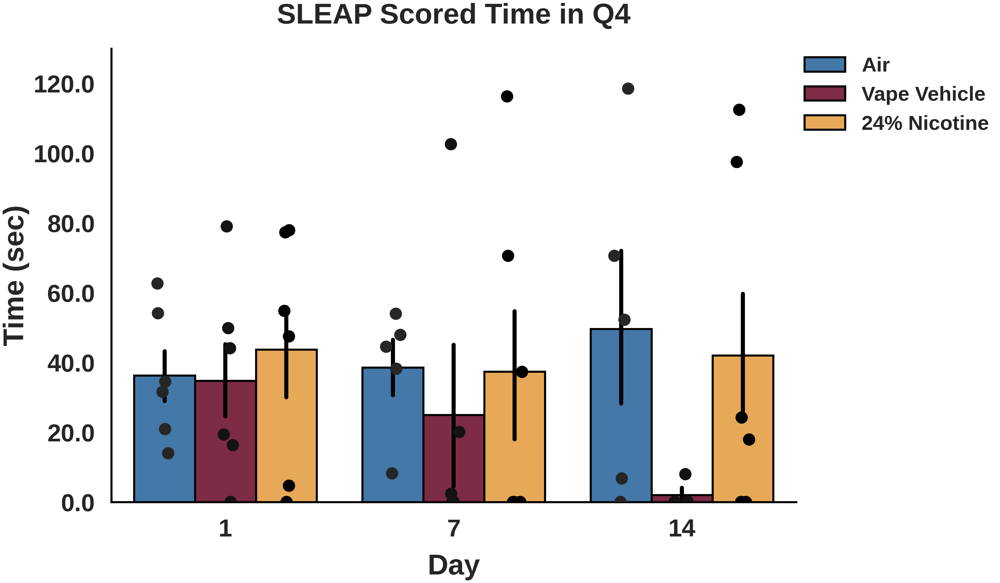

In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Comparisons Formatted")
df1 = get_as_dataframe(sheet).dropna(axis=0, how='all').dropna(axis=1, how='all')
df1 = df1[df1.Day != 2]
df1 = df1[df1.Day != 3]
df1 = df1[df1.Day != 4]
df1 = df1[df1.Day != 5]
df1 = df1[df1.Day != 6]
df1 = df1[df1.Day != 8]
df1 = df1[df1.Day != 9]
df1 = df1[df1.Day != 10]
df1 = df1[df1.Day != 11]
df1 = df1[df1.Day != 12]
df1 = df1[df1.Day != 13]
df1 = df1[df1.Quadrant == 'Q4']
# df1 = df1[df1.ScoreType == 'Hand Scored']
df1 = df1[df1.ScoreType == 'SLEAP']
df1['Time'] = pd.to_numeric(df1['Time'], errors='coerce')
df1.reset_index(drop=True, inplace=True)
# pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
plt.figure(figsize = (3*s,2*s))
plt.ylim(0,130)
palette={'Air':'#3279ba','Water':'#8C1D40','Water + Nicotine':'#ffab40'}
hue_order = ['Air', 'Water', 'Water + Nicotine']

# Create the bar plot
ax = sns.barplot(x=df1.Day, y= df1.Time, data=df1, hue=df1.Group, dodge=True, palette=palette, linewidth=s/2,
                 edgecolor='black', hue_order = hue_order, errorbar=('ci', 69), err_kws={'color': 'black', 'linewidth': s})
ax.set_xticklabels(['','1','7','14'],fontsize=12, fontweight='bold')
sns.stripplot(x=df1.Day, y= df1.Time, data=df1, hue=df1.Group, dodge=True, palette='dark:#000000',
                 hue_order = hue_order, jitter=True, size=s*3, legend = False)

# Adjust Legend
if(ax.get_legend() != None):
  legend_labels = ['Air', 'Vape Vehicle', '24% Nicotine']
  leg = plt.legend(bbox_to_anchor=(1, 1),loc='upper left', borderaxespad=0, markerscale = 10*s, prop={'size':5*s})
  for t, l in zip(leg.texts, legend_labels):
      t.set_text(l)
      t.set_fontweight('bold')

# #Adjust Gridlines
sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')
ax.tick_params(pad = 4*s, labelsize = 6*s)
loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
ax.xaxis.set_major_locator(loc)

#Adjust Labels/Titles
plt.ylabel('Time (sec)',fontsize=7*s,  labelpad = 1*s, fontweight = 'bold' )
plt.xlabel('Day', fontsize=7*s, labelpad = 3*s, fontweight = 'bold' )

if df1.ScoreType[0] == 'Hand Scored':
  plt.title(f'Hand Scored Time in {df1.Quadrant[0]}', fontsize=7*s, fontweight = 'bold' , y=1.05)
else:
  plt.title(f'SLEAP Scored Time in {df1.Quadrant[0]}', fontsize=7*s, fontweight = 'bold' , y=1.05)

plt.savefig(f'{df1.ScoreType[0]}_{df1.Quadrant[0]}.svg', format='svg', bbox_inches='tight')
files.download(f'{df1.ScoreType[0]}_{df1.Quadrant[0]}.svg')

##🟣 Plot avg DISTANCE travelled in each quadrant per group

<ipython-input-41-b3c73dc9e2dd>:23: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['','Quartile 1','Quartile 2','Quartile 3', 'Quartile 4'],fontsize=12, fontweight='bold')
<ipython-input-41-b3c73dc9e2dd>:43: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')


Text(0.5, 0, '')

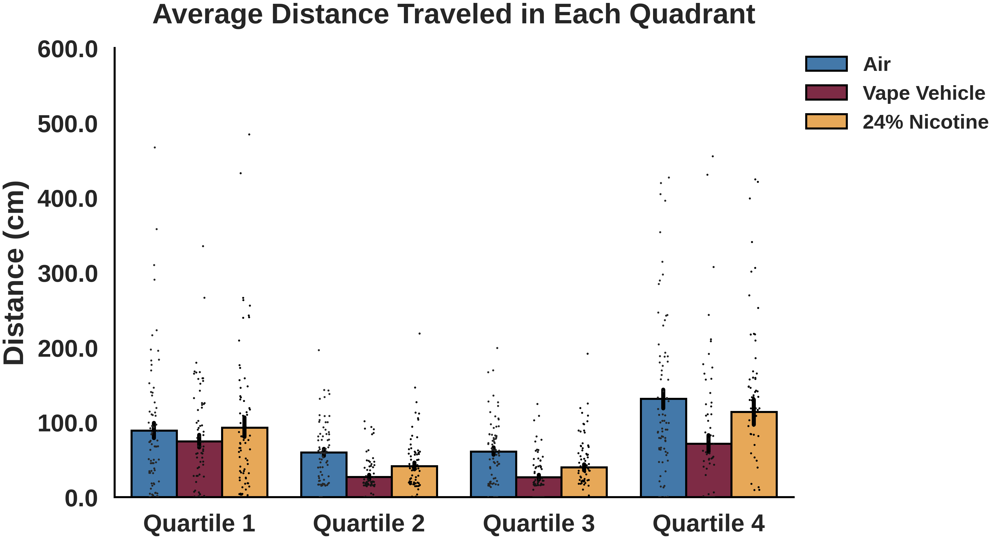

In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(axis=0, how='all').dropna(axis=1, how='all')
df1 = df[df.Group.notna()]
df1 = df1[df1.Day.notna()]
df1 = df1[df1.Distance.notna()]
df1 = df1[df1.ScoreType == 'SLEAP']
# df1 = df1[df1.ScoreType == 'Hand Scored']
# df1 = df1[df1.Group == 'Water']
df1['Distance'] = pd.to_numeric(df1['Distance'], errors='coerce')
df1.reset_index(drop=True, inplace=True)
# pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
plt.figure(figsize = (3*s,2*s))
# plt.ylim(0,130)
plt.ylim(0,600)
palette={'Air':'#3279ba','Water':'#8C1D40','Water + Nicotine':'#ffab40'}
hue_order = ['Air', 'Water', 'Water + Nicotine']

# Create the bar plot
ax = sns.barplot(x=df1.Quadrant, y= df1.Distance*100, data=df1, hue=df1.Group, dodge=True, palette=palette, linewidth=s/2,
                 edgecolor='black', hue_order = hue_order, errorbar=('ci', 69),  err_kws={'color': 'black', 'linewidth': s})
ax.set_xticklabels(['','Quartile 1','Quartile 2','Quartile 3', 'Quartile 4'],fontsize=12, fontweight='bold')
sns.stripplot(x=df1.Quadrant, y= df1.Distance*100, data=df1, hue=df1.Group, dodge=True, palette='dark:#000000',
                 hue_order = hue_order, jitter=True, size=s/2, legend = False)

# Adjust Legend
if(ax.get_legend() != None):
  legend_labels = ['Air', 'Vape Vehicle', '24% Nicotine']
  # leg = plt.legend(bbox_to_anchor=(1, 1.4),loc='upper right', borderaxespad=0, markerscale = 10*s, prop={'size':5*s})
  leg = plt.legend(bbox_to_anchor=(1.3, 1),loc='upper right', borderaxespad=0, markerscale = 10*s, prop={'size':5*s})
  for t, l in zip(leg.texts, legend_labels):
      t.set_text(l)
      t.set_fontweight('bold')

#Adjust Gridlines
sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')
ax.tick_params(pad = 4*s, labelsize = 6*s)
loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
ax.xaxis.set_major_locator(loc)

plt.title(f'Average Distance Traveled in Each Quadrant', fontsize=7*s, fontweight = 'bold', y=1.05)

#Adjust Labels/Titles
plt.ylabel('Distance (cm)',fontsize=7*s,  labelpad = 2*s, fontweight = 'bold' )
plt.xlabel('',fontsize=0*s,  labelpad = 1*s, fontweight = 'bold' )

# plt.savefig(f'fig.svg', format='svg', bbox_inches='tight')
# files.download(f'fig.svg')

### As Barplot

<ipython-input-16-c0b2c2281135>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['','Air','Vape Vehicle','24% Nicotine'],fontsize=18, fontweight='bold')
<ipython-input-16-c0b2c2281135>:36: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize=20, fontweight='bold')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

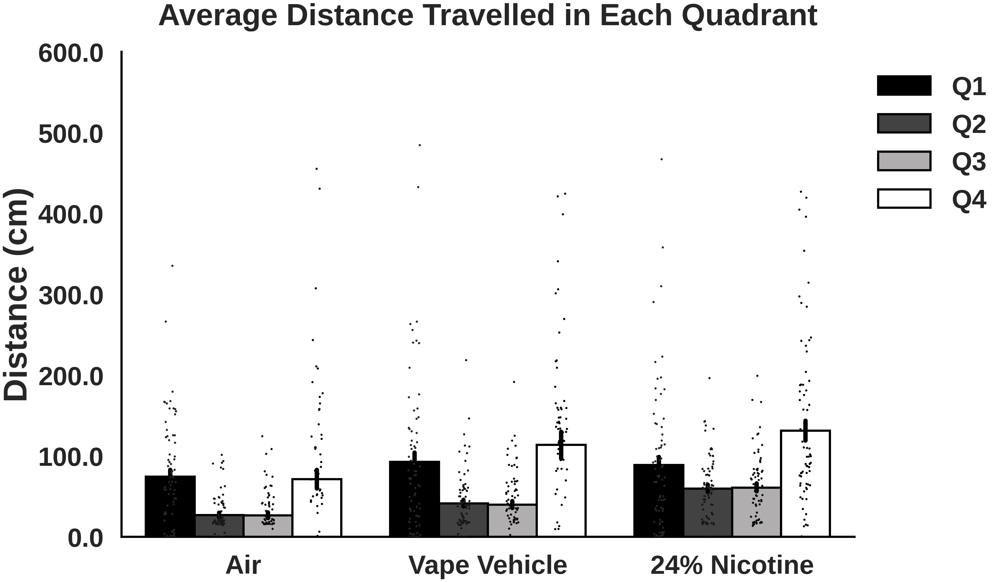

In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(axis=0, how='all').dropna(axis=1, how='all')
df1 = df[df.Group.notna()]
df1 = df1[df1.Day.notna()]
df1['Distance'] = pd.to_numeric(df1['Distance'], errors='coerce')
df1.reset_index(drop=True, inplace=True)
# pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
plt.figure(figsize = (3*s,2*s))
# plt.ylim(0,130)
plt.ylim(0,600)
palette = {'Q1': '#000000', 'Q2': '#424242', 'Q3': '#b0aeae', 'Q4': '#ffffff'}
hue_order = ['Q1', 'Q2', 'Q3', 'Q4']

ax = sns.barplot(x=df1.Group, y= df1.Distance*100, data=df1, hue=df1.Quadrant, dodge=True, palette=palette,
                 linewidth=s/2, edgecolor='black', hue_order = hue_order, errorbar=('ci', 69), err_kws={'color': 'black', 'linewidth': s})
ax.set_xticklabels(['','Air','Vape Vehicle','24% Nicotine'],fontsize=18, fontweight='bold')
sns.stripplot(x=df1.Group, y= df1.Distance*100, data=df1, hue=df1.Quadrant, dodge=True, palette='dark:#000000',
                 hue_order = hue_order, jitter=True, size=s/2, legend = False)

# Adjust Legend
legend_labels = ['Q1', 'Q2', 'Q3', 'Q4']
leg = plt.legend(bbox_to_anchor=(1.0, 1), loc='upper left', prop={'size':6*s})
for t, l in zip(leg.texts, legend_labels):
    t.set_text(l)
    t.set_fontweight('bold')

#Adjust Gridlines
sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
ax.set_yticklabels(ax.get_yticks(),fontsize=20, fontweight='bold')
ax.tick_params(pad = 4*s, labelsize = 6*s)
loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
ax.xaxis.set_major_locator(loc)

plt.title(f'Average Distance Travelled in Each Quadrant', fontsize=7*s, fontweight = 'bold', y=1.05)

#Adjust Labels/Titles
plt.ylabel('Distance (cm)',fontsize=7.5*s,  labelpad = 1*s, fontweight = 'bold' )
plt.xlabel('',fontsize=0*s,  labelpad = 1*s, fontweight = 'bold' )

plt.savefig(f'fig.svg', format='svg', bbox_inches='tight')
files.download(f'fig.svg')

### As Stacked Barplot

<ipython-input-67-e5cab7d7207a>:45: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize=16*s, fontweight='bold')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<Figure size 300x200 with 0 Axes>

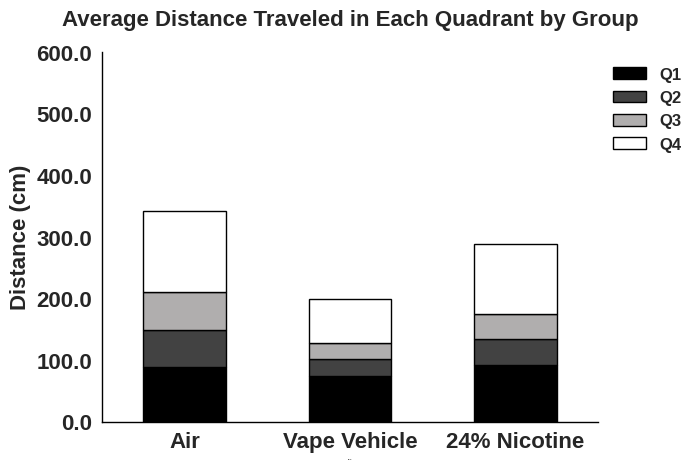

In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(axis=0, how='all').dropna(axis=1, how='all')
df1 = df[df.Group.notna()]
df1 = df1[df1.Day.notna()]
df1 = df1[df1.Distance.notna()]
df1 = df1[df1.ScoreType == 'SLEAP']
df1['Distance'] = pd.to_numeric(df1['Distance'], errors='coerce')
df1['Distance'] = df1['Distance'] * 100
df1.reset_index(drop=True, inplace=True)

# Set the figure size
plt.figure(figsize=(3, 2))
s= 1

# Pivot the DataFrame to have 'Group' as index, 'Quadrant' as columns, and 'Time' as values
df1['Quadrant'] = df1['Quadrant'].str.strip()
df_pivot = df1.pivot_table(index='Group', columns='Quadrant', values='Distance', aggfunc='mean')
palette = {'Q1': '#000000', 'Q2': '#424242', 'Q3': '#b0aeae', 'Q4': '#ffffff'}
ax = df_pivot.plot(kind='bar', stacked=True, color=[palette[col] for col in df_pivot.columns], edgecolor='black')

# Adjust legend, gridlines, spines
legend_labels = ['Q1', 'Q2', 'Q3', 'Q4']
leg = plt.legend(bbox_to_anchor=(1.0, 1), loc='upper left', prop={'size':12*s})
for t, l in zip(leg.texts, legend_labels):
    t.set_text(l)
    t.set_fontweight('bold')

sns.despine(right=True)
plt.grid(False)
plt.ylim(0,600)
ax.spines['left'].set_linewidth(s)
ax.spines['bottom'].set_linewidth(s)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')

# Adjust ticks and labels
new_labels = ['Air','Vape Vehicle','24% Nicotine']
plt.xticks(range(len(new_labels)), new_labels, rotation=0,fontsize=16*s, fontweight='bold')
plt.yticks(fontsize=14*s, fontweight='bold')

# Add title and labels
plt.title('Average Distance Traveled in Each Quadrant by Group', fontsize= 16*s, fontweight='bold', y=1.05)
plt.xlabel('Group', fontsize=0*s, fontweight='bold')
ax.tick_params(pad = 7*s)
ax.set_yticklabels(ax.get_yticks(),fontsize=16*s, fontweight='bold')
plt.ylabel('Distance (cm)', fontsize=16*s, fontweight='bold')

plt.savefig(f'fig.svg', format='svg', bbox_inches='tight')
files.download(f'fig.svg')

### As Lineplot

Confidence intervals for Water and Water + Nicotine overlap. No significant difference.
Confidence intervals for Water and Air overlap. No significant difference.
Confidence intervals for Water + Nicotine and Air overlap. No significant difference.


<ipython-input-284-0af0963d0106>:44: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')


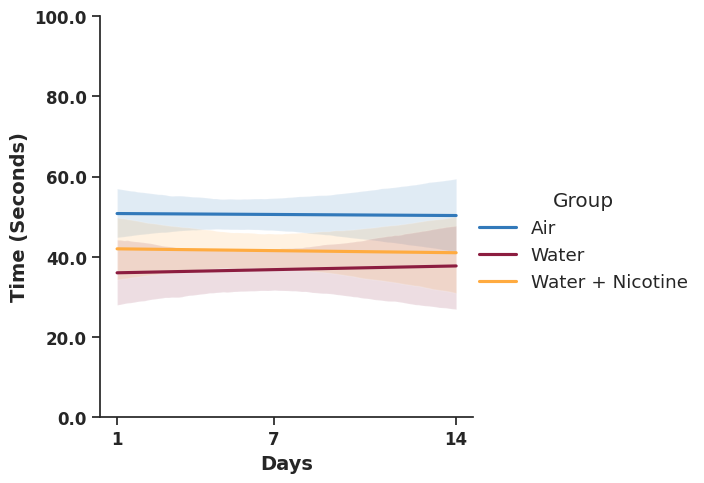

In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(axis=0, how='all').dropna(axis=1, how='all')
df1 = df[df.Group.notna()]
# df1 = df1[df1.Day != 2]
# df1 = df1[df1.Day != 3]
# df1 = df1[df1.Day != 4]
# df1 = df1[df1.Day != 5]
# df1 = df1[df1.Day != 6]
# df1 = df1[df1.Day != 8]
# df1 = df1[df1.Day != 9]
# df1 = df1[df1.Day != 10]
# df1 = df1[df1.Day != 11]
# df1 = df1[df1.Day != 12]
# df1 = df1[df1.Day != 13]
df1 = df1[df1.Quadrant == 'Q4']
df1 = df1[df1.ScoreType == 'Hand Scored']
# df1 = df1[df1.ScoreType == 'SLEAP']

df1['Time'] = pd.to_numeric(df1['Time'], errors='coerce')
pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
palette={'Air':'#3279ba','Water':'#8C1D40','Water + Nicotine':'#ffab40'}
hue_order = ['Air', 'Water', 'Water + Nicotine']

#Create Regression Plot
g = sns.lmplot(
    x="Day",  # X-axis data
    y="Time",  # Y-axis data
    hue="Group",  # Color by 'Group'
    data=df1,  # Filtered data for Q4 only
    ci=68,  # Suppress confidence intervals for regression lines
    palette = palette,
    scatter = False,
    hue_order=hue_order
)

# #Adjust Gridlines
for ax in g.axes.flatten():
    ax.grid(False)
    ax.set_xticks([1, 7, 14])  # Set custom x-axis ticks
    ax.set_xticklabels(['1', '7', '14'], fontsize=12, fontweight='bold')  # Set custom x-axis tick labels
    ax.set_ylim(0, 100)
ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')
g.set_axis_labels("Days", "Time (Seconds)", fontsize=14, fontweight='bold')

# Fit separate linear regression models for each group
groups = df1['Group'].unique()
models = {}

for group in groups:
    group_data = df1[df1['Group'] == group]
    model = sm.OLS(group_data['Time'], sm.add_constant(group_data['Day'])).fit()
    models[group] = model

# Extract coefficients and standard errors for each group
coefficients = pd.DataFrame(columns=['Group', 'Coefficient', 'Std_Error'])

for group, model in models.items():
    coeff = model.params['Day']
    std_err = model.bse['Day']
    coefficients = pd.concat([coefficients, pd.DataFrame([{'Group': group, 'Coefficient': coeff, 'Std_Error': std_err}])], ignore_index=True)

# Compare coefficients (slopes) among groups
# For example, here we check for significant differences using confidence intervals
for i in range(len(coefficients)):
    for j in range(i + 1, len(coefficients)):
        group1 = coefficients.iloc[i]
        group2 = coefficients.iloc[j]
        ci1 = (group1['Coefficient'] - 1.96 * group1['Std_Error'], group1['Coefficient'] + 1.96 * group1['Std_Error'])
        ci2 = (group2['Coefficient'] - 1.96 * group2['Std_Error'], group2['Coefficient'] + 1.96 * group2['Std_Error'])

        # Check if confidence intervals overlap
        if ci1[0] <= ci2[1] and ci2[0] <= ci1[1]:
            print(f"Confidence intervals for {group1['Group']} and {group2['Group']} overlap. No significant difference.")
        else:
            print(f"Confidence intervals for {group1['Group']} and {group2['Group']} do not overlap. Significant difference detected.")

##🟣 Plot avg TIME spent in each quadrant per group

<ipython-input-50-20b8370fe7da>:20: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['','Quartile 1','Quartile 2','Quartile 3', 'Quartile 4'],fontsize=12, fontweight='bold')
<ipython-input-50-20b8370fe7da>:40: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')


Text(0.5, 0, 'Quartiles')

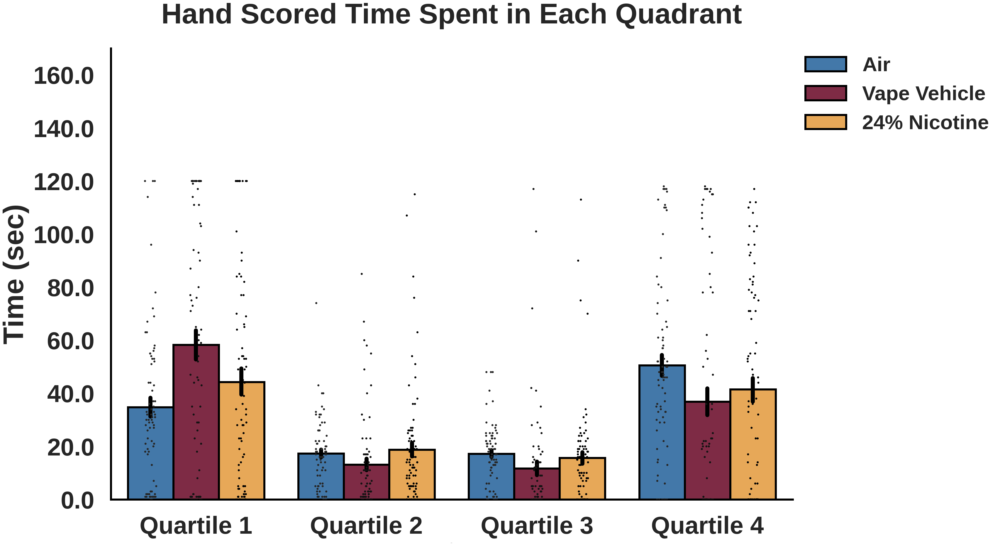

In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(axis=0, how='all').dropna(axis=1, how='all')
df1 = df[df.Group.notna()]
df1 = df1[df1.Day.notna()]
df1['Time'] = pd.to_numeric(df1['Time'], errors='coerce')
df1 = df1[df1.ScoreType == 'Hand Scored']
# df1 = df1[df1.ScoreType == 'SLEAP']
df1.reset_index(drop=True, inplace=True)
# pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
plt.figure(figsize = (3*s,2*s))
# plt.ylim(0,130)
plt.ylim(0,170)
palette={'Air':'#3279ba','Water':'#8C1D40','Water + Nicotine':'#ffab40'}
hue_order = ['Air', 'Water', 'Water + Nicotine']

ax = sns.barplot(x=df1.Quadrant, y= df1.Time, data=df1, hue=df1.Group, dodge=True, palette=palette,
                 linewidth=s/2, edgecolor='black', hue_order = hue_order, errorbar=('ci', 69), err_kws={'color': 'black', 'linewidth': s})
ax.set_xticklabels(['','Quartile 1','Quartile 2','Quartile 3', 'Quartile 4'],fontsize=12, fontweight='bold')
sns.stripplot(x=df1.Quadrant, y= df1.Time, data=df1, hue=df1.Group, dodge=True, palette='dark:#000000',
                 hue_order = hue_order, jitter=True, size=s/2, legend = False)

# Adjust Legend
if(ax.get_legend() != None):
  legend_labels = ['Air', 'Vape Vehicle', '24% Nicotine']
  # leg = plt.legend(bbox_to_anchor=(1, 1.4),loc='upper right', borderaxespad=0, markerscale = 10*s, prop={'size':5*s})
  leg = plt.legend(bbox_to_anchor=(1.3, 1),loc='upper right', borderaxespad=0, markerscale = 10*s, prop={'size':5*s})
  for t, l in zip(leg.texts, legend_labels):
      t.set_text(l)
      t.set_fontweight('bold')

#Adjust Gridlines
sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')
ax.tick_params(pad = 4*s, labelsize = 6*s)
loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
ax.xaxis.set_major_locator(loc)

if df1.ScoreType[0] == 'Hand Scored':
  plt.title(f'Hand Scored Time Spent in Each Quadrant', fontsize=7*s, fontweight = 'bold' , y=1.05)
else:
  plt.title(f'SLEAP Scored Time Spent in Each Quadrant', fontsize=7*s, fontweight = 'bold', y=1.05)

#Adjust Labels/Titles
plt.ylabel('Time (sec)',fontsize=7*s,  labelpad = 1*s, fontweight = 'bold' )
plt.xlabel('Quartiles',fontsize=0*s,  labelpad = 1*s, fontweight = 'bold' )

# plt.savefig(f'fig.svg', format='svg', bbox_inches='tight')
# files.download(f'fig.svg')

### As Stacked Barplot

<ipython-input-90-e11aa4c90a65>:50: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize=16*s, fontweight='bold')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<Figure size 300x200 with 0 Axes>

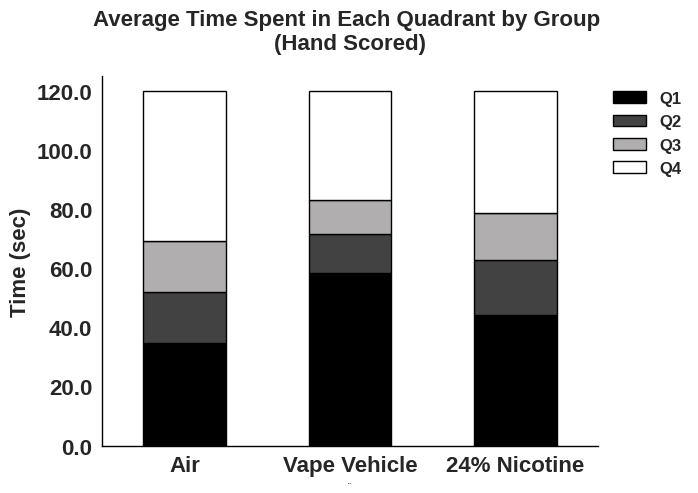

In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(axis=0, how='all').dropna(axis=1, how='all')
df1 = df[df.Group.notna()]
df1 = df1[df1.Day.notna()]
# df1 = df1[df1.ScoreType == 'SLEAP']
df1 = df1[df1.ScoreType == 'Hand Scored']
df1['Distance'] = pd.to_numeric(df1['Distance'], errors='coerce')
df1.reset_index(drop=True, inplace=True)

pd.DataFrame.from_records(df1)

# Set the figure size
plt.figure(figsize=(3, 2))
s= 1

# Pivot the DataFrame to have 'Group' as index, 'Quadrant' as columns, and 'Time' as values
df1['Quadrant'] = df1['Quadrant'].str.strip()
df_pivot = df1.pivot_table(index='Group', columns='Quadrant', values='Time', aggfunc='mean')
palette = {'Q1': '#000000', 'Q2': '#424242', 'Q3': '#b0aeae', 'Q4': '#ffffff'}
ax = df_pivot.plot(kind='bar', stacked=True, color=[palette[col] for col in df_pivot.columns], edgecolor='black')

# Adjust legend, gridlines, spines
legend_labels = ['Q1', 'Q2', 'Q3', 'Q4']
leg = plt.legend(bbox_to_anchor=(1.0, 1), loc='upper left', prop={'size':12*s})
for t, l in zip(leg.texts, legend_labels):
    t.set_text(l)
    t.set_fontweight('bold')

sns.despine(right=True)
plt.grid(False)
plt.ylim(0,125)
ax.spines['left'].set_linewidth(s)
ax.spines['bottom'].set_linewidth(s)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')

# Adjust ticks and labels
new_labels = ['Air','Vape Vehicle','24% Nicotine']
plt.xticks(range(len(new_labels)), new_labels, rotation=0,fontsize=16*s, fontweight='bold')
plt.yticks(fontsize=14*s, fontweight='bold')

# Add title and labels
if df1.ScoreType[0] == 'Hand Scored':
  plt.title('Average Time Spent in Each Quadrant by Group \n(Hand Scored)', fontsize= 16*s, fontweight='bold', y=1.05)
else:
  plt.title(f'Average Time Spent in Each Quadrant by Group \n(SLEAP Scored)', fontsize=16*s, fontweight = 'bold', y=1.05)

plt.xlabel('Group', fontsize=0*s, fontweight='bold')
ax.tick_params(pad = 7*s)
ax.set_yticklabels(ax.get_yticks(),fontsize=16*s, fontweight='bold')
plt.ylabel('Time (sec)', fontsize=16*s, fontweight='bold')

plt.savefig(f'fig.svg', format='svg', bbox_inches='tight')
files.download(f'fig.svg')

### Within Group

<ipython-input-53-2313600e56a1>:20: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['','Air','Vape Vehicle','24% Nicotine'],fontsize=12, fontweight='bold')
<ipython-input-53-2313600e56a1>:38: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

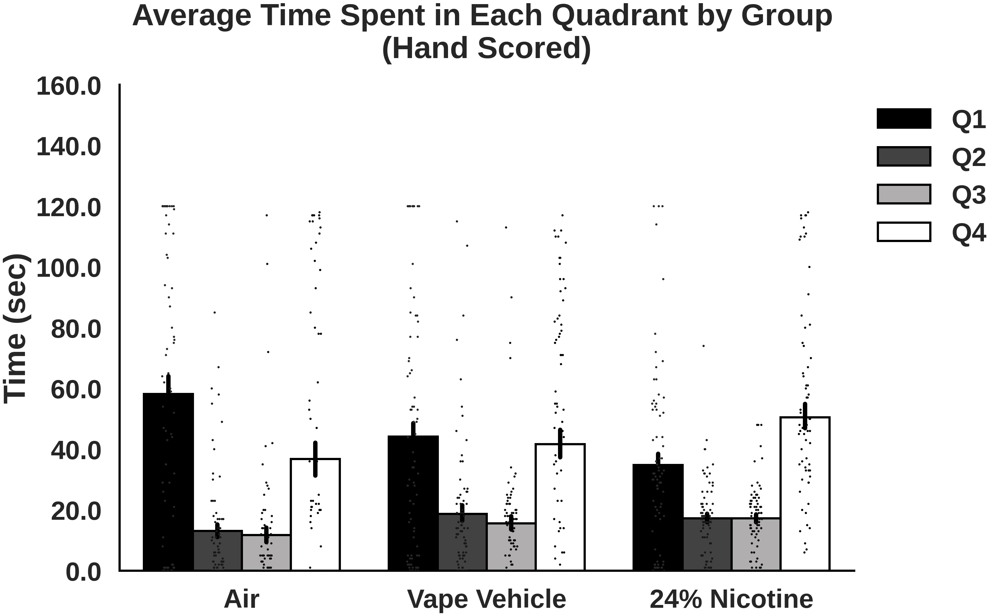

In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(axis=0, how='all').dropna(axis=1, how='all')
df1 = df[df.Group.notna()]
df1 = df1[df1.Day.notna()]
df1['Time'] = pd.to_numeric(df1['Time'], errors='coerce')
df1 = df1[df1.ScoreType == 'Hand Scored']
# df1 = df1[df1.ScoreType == 'SLEAP']
df1.reset_index(drop=True, inplace=True)
# pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
plt.figure(figsize = (3*s,2*s))
# plt.ylim(0,130)
plt.ylim(0,160)
palette = {'Q1': '#000000', 'Q2': '#424242', 'Q3': '#b0aeae', 'Q4': '#ffffff'}
hue_order = ['Q1', 'Q2', 'Q3', 'Q4']

ax = sns.barplot(x=df1.Group, y= df1.Time, data=df1, hue=df1.Quadrant, dodge=True, palette=palette,
                 linewidth=s/2, edgecolor='black', hue_order = hue_order, errorbar=('ci', 69), err_kws={'color': 'black', 'linewidth': s})
ax.set_xticklabels(['','Air','Vape Vehicle','24% Nicotine'],fontsize=12, fontweight='bold')
sns.stripplot(x=df1.Group, y= df1.Time, data=df1, hue=df1.Quadrant, dodge=True, palette='dark:#000000',
                 hue_order = hue_order, jitter=True, size=s/2, legend = False)

# Adjust Legend
legend_labels = ['Q1', 'Q2', 'Q3', 'Q4']
leg = plt.legend(bbox_to_anchor=(1.0, 1), loc='upper left', prop={'size':6*s})
for t, l in zip(leg.texts, legend_labels):
    t.set_text(l)
    t.set_fontweight('bold')

#Adjust Gridlines
sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')
ax.tick_params(pad = 4*s, labelsize = 6*s)
loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
ax.xaxis.set_major_locator(loc)

if df1.ScoreType[0] == 'Hand Scored':
  plt.title('Average Time Spent in Each Quadrant by Group \n(Hand Scored)', fontsize= 7*s, fontweight='bold', y=1.05)
else:
  plt.title(f'Average Time Spent in Each Quadrant by Group \n(SLEAP Scored)', fontsize=7*s, fontweight = 'bold', y=1.05)

#Adjust Labels/Titles
plt.ylabel('Time (sec)',fontsize=7*s,  labelpad = 1*s, fontweight = 'bold' )
plt.xlabel('',fontsize=0*s,  labelpad = 1*s, fontweight = 'bold' )

plt.savefig(f'fig.svg', format='svg', bbox_inches='tight')
files.download(f'fig.svg')

##🟣 Plot avg VELOCITY travelled in each quadrant per group

<ipython-input-42-11aa5368e57c>:26: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(), rotation = 0, fontsize=12, fontweight='bold')
<ipython-input-42-11aa5368e57c>:27: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([""]+node_names, rotation = 90, fontsize=12, fontweight='bold')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

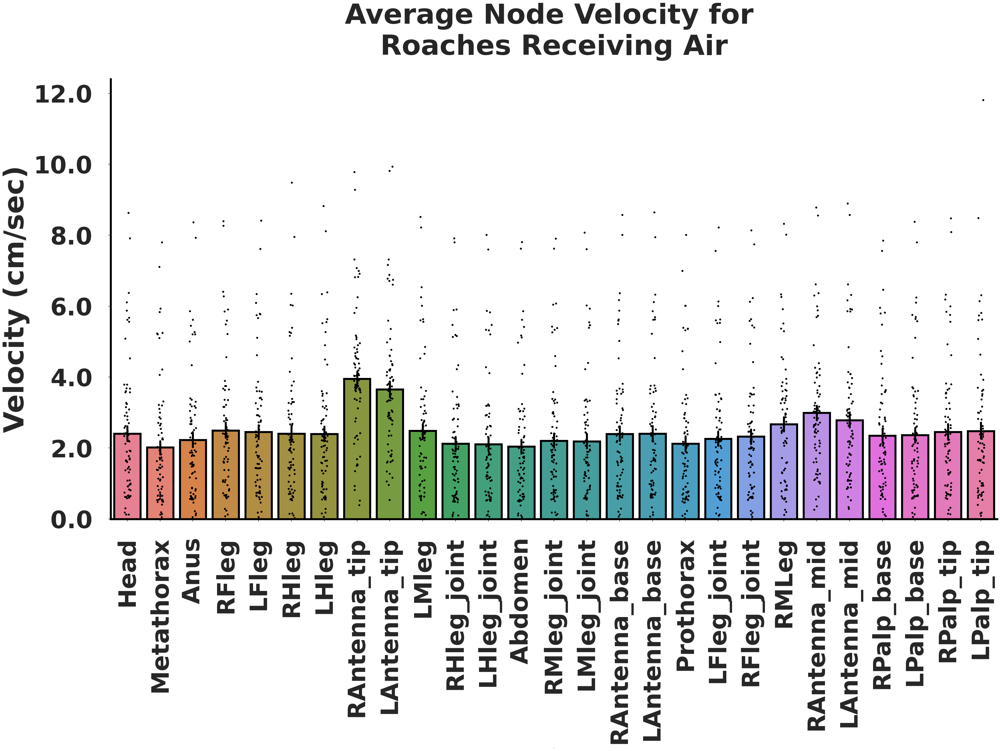

In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Velocity Data")
df = get_as_dataframe(sheet)
df = df[df.Group == 'Air']
# df = df[df.Group == 'Water']
# df = df[df.Group == 'Water + Nicotine']
# df = df[df.Day == 1]
df1 = pd.melt(df, id_vars= ['Day','Group','File'], var_name='Nodes', value_name="Velocity")
pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
plt.figure(figsize = (4*s,2*s))

# Create the bar plot
ax = sns.barplot(x=df1.Nodes, y= df1.Velocity, data=df1, hue = df1.Nodes, palette='husl', width = .8,
                 err_kws={'color': 'black','linewidth': s/2}, linewidth=s/2, edgecolor='black', errorbar=('ci', 69))
sns.stripplot(x=df1.Nodes, y= df1.Velocity, data=df1,  dodge=True, color = '#000000',
                  jitter=True, size=s/2, legend = False)

#Adjust Gridlines
sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
ax.set_yticklabels(ax.get_yticks(), rotation = 0, fontsize=12, fontweight='bold')
ax.set_xticklabels([""]+node_names, rotation = 90, fontsize=12, fontweight='bold')
ax.tick_params(pad = 4*s, labelsize = 6*s)
loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
ax.xaxis.set_major_locator(loc)

plt.title(f'Average Node Velocity for \nRoaches Receiving {df1.Group[0]}', fontsize=7*s, fontweight = 'bold', y=1.05)

#Adjust Labels/Titles
plt.ylabel('Velocity (cm/sec)',fontsize=7*s,  labelpad = 1*s, fontweight = 'bold' )
plt.xlabel('Nodes',fontsize=0*s,  labelpad = 1*s, fontweight = 'bold' )

# plt.savefig('fig.svg', format='svg', bbox_inches='tight')
# files.download('fig.svg')

<ipython-input-355-2bcf6097034b>:26: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['', '0', '5', '10', '15', '20', '25'], rotation = 0, fontsize=12, fontweight='bold')
<ipython-input-355-2bcf6097034b>:27: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(node_names, rotation = 0, fontsize=12, fontweight='bold')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

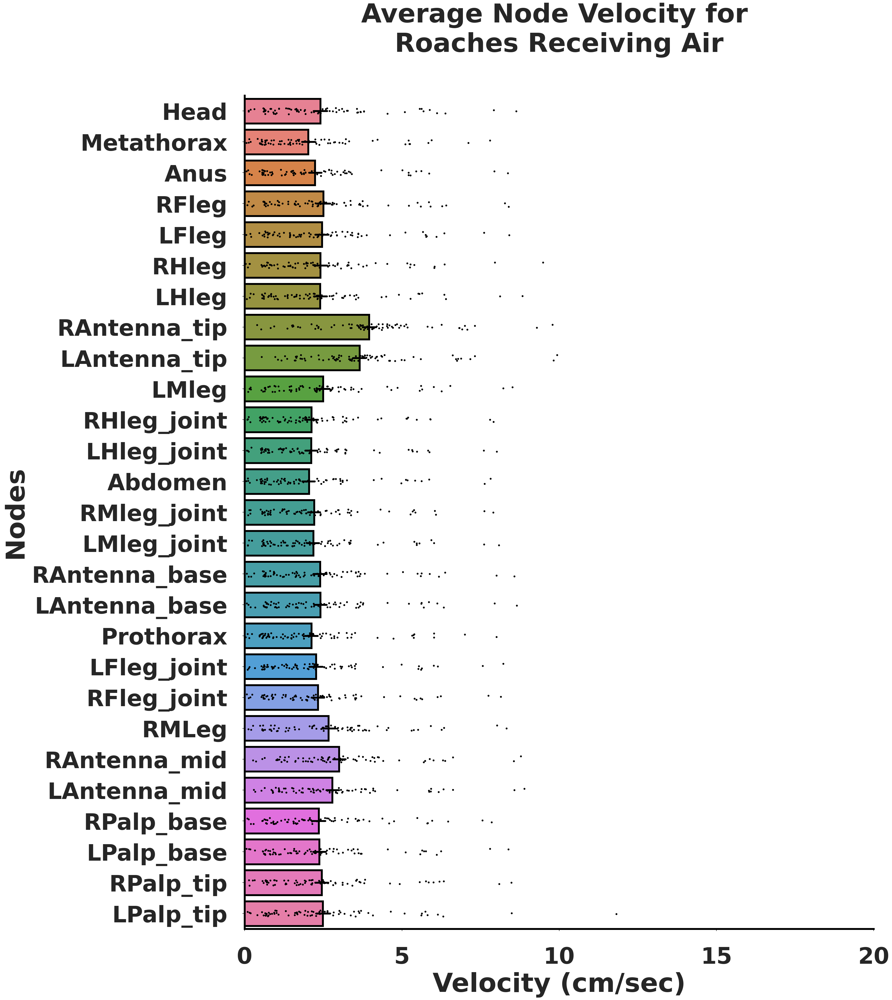

In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Velocity Data")
df = get_as_dataframe(sheet)
df = df[df.Group == 'Air']
# df = df[df.Group == 'Water']
# df = df[df.Group == 'Water + Nicotine']
# df = df[df.Day == 1]
df1 = pd.melt(df, id_vars= ['Day','Group','File'], var_name='Nodes', value_name="Velocity")
pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
plt.figure(figsize = (3*s,4*s))

# Create the bar plot
ax = sns.barplot(x=df1.Velocity, y= df1.Nodes, data=df1, hue = df1.Nodes, palette='husl', width = .8,
                 err_kws={'color': 'black','linewidth': s/2}, linewidth=s/2, edgecolor='black', errorbar=('ci', 69))
sns.stripplot(x=df1.Velocity, y= df1.Nodes, data=df1,  dodge=True, color = '#000000',
                  jitter=True, size=s/2, legend = False)
ax.set_xlim(0,20)
#Adjust Gridlines
sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
ax.set_xticklabels(['', '0', '5', '10', '15', '20', '25'], rotation = 0, fontsize=12, fontweight='bold')
ax.set_yticklabels(node_names, rotation = 0, fontsize=12, fontweight='bold')
ax.tick_params(pad = 4*s, labelsize = 6*s)
loc = plticker.MultipleLocator(base=5.0) # this locator puts ticks at regular intervals
ax.xaxis.set_major_locator(loc)

if(df1.Group[0] == 'Water'):
  plt.title(f'Average Node Velocity for \nRoaches Receiving Vape Vehicle', fontsize=7*s, fontweight = 'bold', y=1.05)
elif(df1.Group[0] == 'Water + Nicotine'):
  plt.title(f'Average Node Velocity for \nRoaches Receiving 24% Nicotine', fontsize=7*s, fontweight = 'bold', y=1.05)
else:
  plt.title(f'Average Node Velocity for \nRoaches Receiving {df1.Group[0]}', fontsize=7*s, fontweight = 'bold', y=1.05)

#Adjust Labels/Titles
plt.xlabel('Velocity (cm/sec)',fontsize=7*s,  labelpad = 1*s, fontweight = 'bold' )
plt.ylabel('Nodes',fontsize=7*s,  labelpad = 1*s, fontweight = 'bold' )

plt.savefig(f'fig.svg', format='svg', bbox_inches='tight')
files.download(f'fig.svg')

### Plot all groups together

In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Velocity Data")
df = get_as_dataframe(sheet)
# df = df[df.Group == 'Air']
# df = df[df.Group == 'Water']
# df = df[df.Group == 'Water + Nicotine']
# df = df[df.Day == 1]
df1 = pd.melt(df, id_vars= ['Day','Group','File'], var_name='Nodes', value_name="Velocity")
# pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
plt.figure(figsize = (6*s,2*s))
palette={'Air':'#3279ba','Water':'#8C1D40','Water + Nicotine':'#ffab40'}
hue_order = ['Air', 'Water', 'Water + Nicotine']
plt.ylim(0,15)

# Create the bar plot
ax = sns.barplot(x=df1.Nodes, y= df1.Velocity, data=df1, palette=palette, hue=df1.Group, hue_order = hue_order,width = .8,
                 err_kws={'color': 'black','linewidth': s/2}, linewidth=s/2, edgecolor='black', errorbar=('ci', 69))
sns.stripplot(x=df1.Nodes, y= df1.Velocity, data=df1,  dodge=True, palette='dark:#000000', hue=df1.Group, hue_order = hue_order,
                  jitter=True, size=s/2, legend = False)

# Adjust Legend
if(ax.get_legend() != None):
  legend_labels = ['Air', 'Vape Vehicle', '24% Nicotine']
  leg = plt.legend(bbox_to_anchor=(1, 1),loc='upper right', borderaxespad=0, markerscale = 10*s, prop={'size':5*s})
  for t, l in zip(leg.texts, legend_labels):
      t.set_text(l)
      t.set_fontweight('bold')
#Adjust Gridlines
sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)

#Adjust Labels/Titles
ax.set_yticklabels(ax.get_yticks(), rotation= 0, fontsize=12, fontweight='bold')
ax.set_xticklabels(node_names, rotation = 90, fontsize=12, fontweight='bold')
ax.tick_params(pad = 4*s, labelsize = 6*s)
# loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
# ax.xaxis.set_major_locator(loc)
plt.ylabel('Velocity (cm/sec)',fontsize=7*s,  labelpad = 1*s, fontweight = 'bold' )
plt.xlabel('Nodes',fontsize=0*s,  labelpad = 1*s, fontweight = 'bold' )
plt.title(f'Average Node Velocities', fontsize=7*s, fontweight = 'bold', y=1.05)

plt.savefig(f'fig.svg', format='svg', bbox_inches='tight')
files.download(f'fig.svg')

,Day,Group,File,Nodes,Velocity
0,1.0,Water,IMG_4336_2,Head,1.242055
1,1.0,Water,IMG_4337_2,Head,1.157179
2,1.0,Water,IMG_4338_2,Head,1.330794
3,1.0,Water,IMG_4339_2,Head,0.468428
4,1.0,Water,IMG_4340_2,Head,3.441959
...,...,...,...,...,...
26941,NaN,NaN,NaN,LPalp_tip,NaN
26942,NaN,NaN,NaN,LPalp_tip,NaN
26943,NaN,NaN,NaN,LPalp_tip,NaN
26944,NaN,NaN,NaN,LPalp_tip,NaN


<ipython-input-359-d857d148db23>:39: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticks(), rotation=0, fontsize=12, fontweight='bold')
<ipython-input-359-d857d148db23>:40: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(node_names, rotation = 0, fontsize=12, fontweight='bold')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

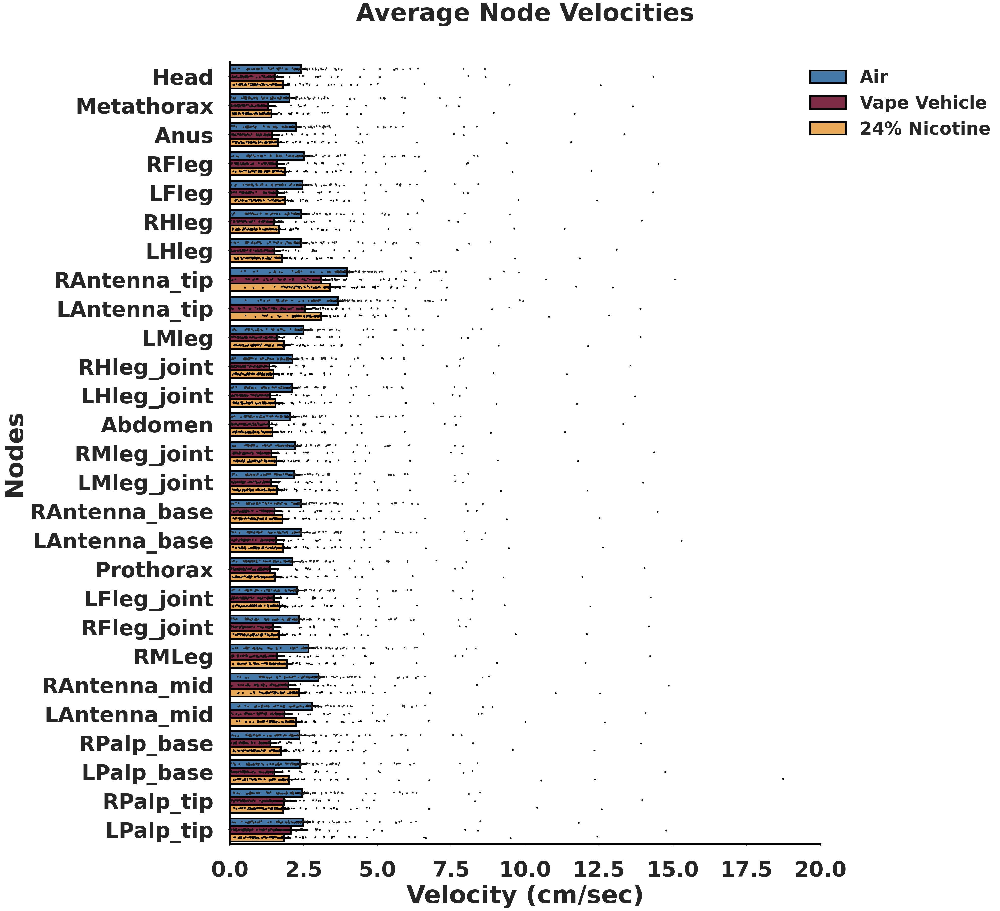

In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Velocity Data")
df = get_as_dataframe(sheet)
# df = df[df.Group == 'Air']
# df = df[df.Group == 'Water']
# df = df[df.Group == 'Water + Nicotine']
# df = df[df.Day == 1]
df1 = pd.melt(df, id_vars= ['Day','Group','File'], var_name='Nodes', value_name="Velocity")
# pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
plt.figure(figsize = (3*s,4*s))
palette={'Air':'#3279ba','Water':'#8C1D40','Water + Nicotine':'#ffab40'}
hue_order = ['Air', 'Water', 'Water + Nicotine']
plt.xlim(0,20)

# Create the bar plot
ax = sns.barplot(x=df1.Velocity, y= df1.Nodes, data=df1, palette=palette, hue=df1.Group, hue_order = hue_order,width = .8,
                 err_kws={'color': 'black','linewidth': s/2}, linewidth=s/2, edgecolor='black', errorbar=('ci', 69))
sns.stripplot(x=df1.Velocity, y= df1.Nodes, data=df1,  dodge=True, palette='dark:#000000', hue=df1.Group, hue_order = hue_order,
                  jitter=True, size=s/2, legend = False)

# Adjust Legend
if(ax.get_legend() != None):
  legend_labels = ['Air', 'Vape Vehicle', '24% Nicotine']
  leg = plt.legend(bbox_to_anchor=(1.3, 1),loc='upper right', borderaxespad=0, markerscale = 10*s, prop={'size':5*s})
  for t, l in zip(leg.texts, legend_labels):
      t.set_text(l)
      t.set_fontweight('bold')

#Adjust Gridlines
sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)

#Adjust Labels/Titles
ax.set_xticklabels(ax.get_xticks(), rotation=0, fontsize=12, fontweight='bold')
ax.set_yticklabels(node_names, rotation = 0, fontsize=12, fontweight='bold')
ax.tick_params(pad = 4*s, labelsize = 6*s)
# loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
# ax.xaxis.set_major_locator(loc)
plt.xlabel('Velocity (cm/sec)',fontsize=7*s,  labelpad = 1*s, fontweight = 'bold' )
plt.ylabel('Nodes',fontsize=7*s,  labelpad = 1*s, fontweight = 'bold' )
plt.title(f'Average Node Velocities', fontsize=7*s, fontweight = 'bold', y=1.05)

plt.savefig(f'fig.svg', format='svg', bbox_inches='tight')
files.download(f'fig.svg')

##🟣  Plot TIME spent over days in certain quadrant

<ipython-input-50-f61e5fcb1679>:29: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15'],
<ipython-input-50-f61e5fcb1679>:31: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(), fontsize=12, fontweight='bold')


Confidence intervals for Water and Water + Nicotine overlap. No significant difference.
Confidence intervals for Water and Air overlap. No significant difference.
Confidence intervals for Water + Nicotine and Air overlap. No significant difference.
                 sum_sq     df         F    PR(>F)
Group      20494.099772    2.0  6.661590  0.001549
Day           13.748462    1.0  0.008938  0.924765
Residual  343025.031747  223.0       NaN       NaN
Regression equation for Water: y = -0.38x + 60.41, R-squared: 0.00
Regression equation for Water + Nicotine: y = 0.47x + 39.73, R-squared: 0.00
Regression equation for Air: y = -0.32x + 36.56, R-squared: 0.00


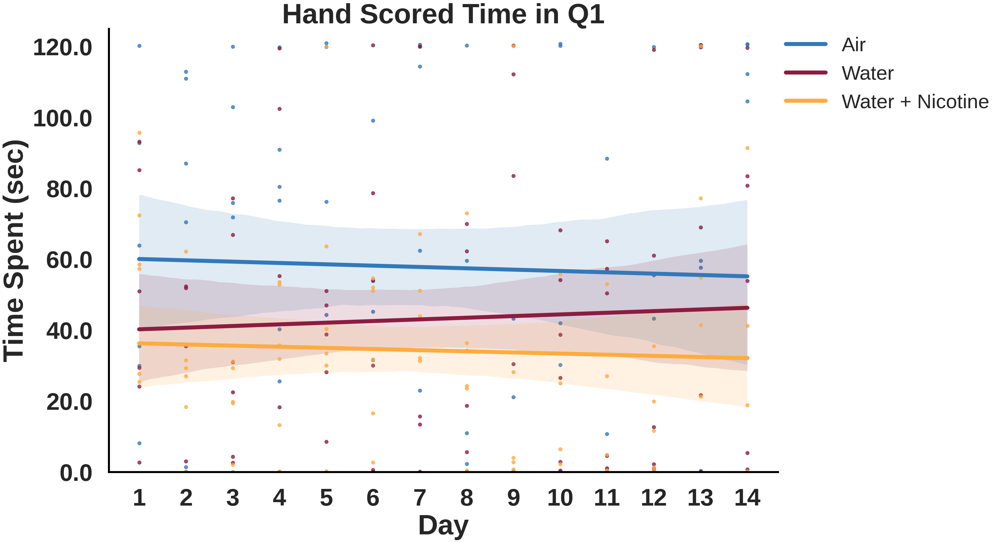

In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(axis=0, how='all').dropna(axis=1, how='all')

# Filtering data
df1 = df[df['Group'].notna() & df['Day'].notna() & (df['ScoreType'] == 'SLEAP') & (df['Quadrant'] == 'Q1')]
# df1 = df[df['Group'].notna() & df['Day'].notna() & (df['ScoreType'] == 'Hand Scored') & (df['Quadrant'] == 'Q4')]
df1 = df1[df1['Time'].notna() & df1['Day'].notna() & df1['Group'].notna() & df1['Subject'].notna()]
df1['Time'] = pd.to_numeric(df1['Time'], errors='coerce')
df1.reset_index(drop=True, inplace=True)

# Plotting
s = 10  # Figure size
plt.figure(figsize=(3 * s, 2 * s))
plt.ylim(0, 125)
palette = {'Air': '#3279ba', 'Water': '#8C1D40', 'Water + Nicotine': '#ffab40'}

for group, color in zip(df1['Group'].unique(), ['#3279ba', '#8C1D40', '#ffab40']):
    group_data = df1[df1['Group'] == group]
    ax = sns.regplot(x='Day', y='Time', data=group_data, marker='o', scatter_kws={'s': 8 * s, 'color': color},
                     line_kws={'color': color, 'linewidth': s}, label=group)  # Added label argument for legend

# Legend adjustment and plot styling
sns.despine(right=True)
ax.spines['left'].set_linewidth(s / 2)
ax.spines['bottom'].set_linewidth(s / 2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
ax.set_xticklabels(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15'],
                   fontsize=12, fontweight='bold')
ax.set_yticklabels(ax.get_yticks(), fontsize=12, fontweight='bold')
ax.tick_params(pad=4 * s, labelsize=6 * s)
loc = plticker.MultipleLocator(base=1.0)
ax.xaxis.set_major_locator(loc)
plt.ylabel('Time Spent (sec)', fontsize=7 * s, labelpad=1 * s, fontweight='bold')
plt.xlabel('Day', fontsize=7 * s, labelpad=1 * s, fontweight='bold')
plt.title(f'Hand Scored Time in {df1.Quadrant[0]}', fontsize=7 * s, fontweight='bold')
handles = [Line2D([0], [0], color='#3279ba', linewidth=s),
           Line2D([0], [0], color='#8C1D40', linewidth=s),
           Line2D([0], [0], color='#ffab40', linewidth=s)]
labels = ['Air', 'Water', 'Water + Nicotine']
plt.legend(handles=handles, labels=labels, bbox_to_anchor=(1, 1), loc='upper left', borderaxespad=0, prop={'size': 5 * s})

# Linear regression and coefficient comparison
models = {}
for group in df1['Group'].unique():
    group_data = df1[df1['Group'] == group]
    model = sm.OLS(group_data['Time'], sm.add_constant(group_data['Day'])).fit()
    models[group] = model

coefficients = pd.DataFrame(columns=['Group', 'Coefficient', 'Std_Error'])
for group, model in models.items():
    coeff = model.params['Day']
    std_err = model.bse['Day']
    coefficients = pd.concat([coefficients, pd.DataFrame([{'Group': group, 'Coefficient': coeff, 'Std_Error': std_err}])],
                              ignore_index=True)

for i in range(len(coefficients)):
    for j in range(i + 1, len(coefficients)):
        group1 = coefficients.iloc[i]
        group2 = coefficients.iloc[j]
        ci1 = (group1['Coefficient'] - 1.96 * group1['Std_Error'], group1['Coefficient'] + 1.96 * group1['Std_Error'])
        ci2 = (group2['Coefficient'] - 1.96 * group2['Std_Error'], group2['Coefficient'] + 1.96 * group2['Std_Error'])
        if ci1[0] <= ci2[1] and ci2[0] <= ci1[1]:
            print(f"Confidence intervals for {group1['Group']} and {group2['Group']} overlap. No significant difference.")
        else:
            print(f"Confidence intervals for {group1['Group']} and {group2['Group']} do not overlap. Significant difference detected.")

# Fit overall regression model
model = ols('Time ~ Day + Group', data=df1).fit()

# Perform ANOVA test for regression
anova_table = sm.stats.anova_lm(model, typ=2)
print(anova_table)

# Linear regression and coefficient comparison
models = {}
equations = {}

for group in df1['Group'].unique():
    group_data = df1[df1['Group'] == group]
    model = sm.OLS(group_data['Time'], sm.add_constant(group_data['Day'])).fit()
    models[group] = model
    slope, intercept = model.params['Day'], model.params['const']
    r_squared = model.rsquared
    equations[group] = f'y = {slope:.2f}x + {intercept:.2f}, R-squared: {r_squared:.2f}'

# Output equations with R-squared values
for group, equation in equations.items():
    print(f"Regression equation for {group}: {equation}")

# plt.savefig(f'fig.svg', format='svg', bbox_inches='tight')
# files.download(f'fig.svg')

## 🟣 Plot difference between hand scoring and machine learning

<ipython-input-103-ef76dad410f6>:30: MatplotlibDeprecationWarning: The legendHandles attribute was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use legend_handles instead.
  for handle, label in zip(leg.legendHandles, legend_labels):
<ipython-input-103-ef76dad410f6>:47: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['', 'Quartile 1','Quartile 2','Quartile 3', 'Quartile 4'],fontsize=12, fontweight='bold')
<ipython-input-103-ef76dad410f6>:56: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

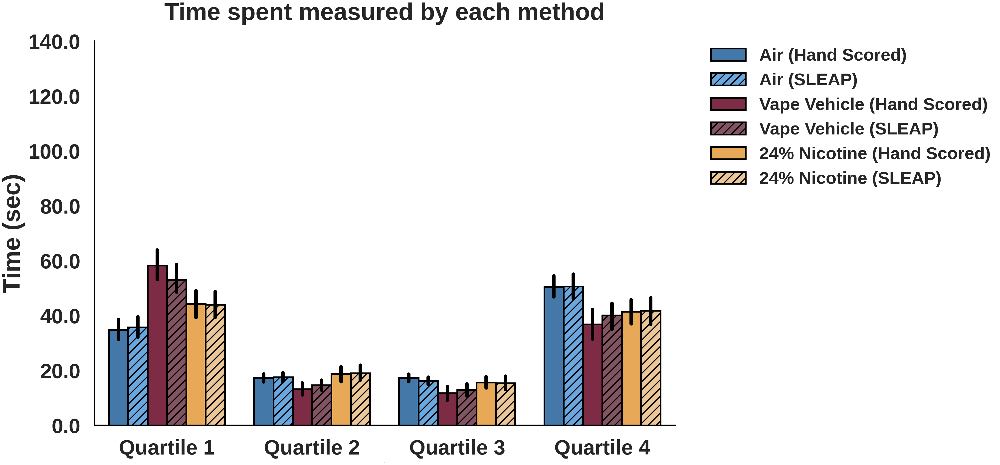

In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(axis=0, how='all').dropna(axis=1, how='all')
df1 = df[df.Group.notna()]
df1 = df1[df1.Day != '3']
df1['Time'] = pd.to_numeric(df1['Time'], errors='coerce')
# pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
plt.figure(figsize = (3*s,2*s))
plt.ylim(0,140)

palette={'Hand Scored - Air':'#3279ba','Hand Scored - Water':'#8C1D40','Hand Scored - Water + Nicotine':'#ffab40',
         'SLEAP - Air':'#57a8f2','SLEAP - Water':'#8a4c5f','SLEAP - Water + Nicotine':'#f7c78b'}

# palette={'Hand Scored - Air':'#3279ba','Hand Scored - Water':'#8C1D40','Hand Scored - Water + Nicotine':'#ffab40',
#          'SLEAP - Air':'#3279ba','SLEAP - Water':'#8C1D40','SLEAP - Water + Nicotine':'#ffab40'}

hue_order = ['Hand Scored - Air', 'SLEAP - Air', 'Hand Scored - Water', 'SLEAP - Water',
             'Hand Scored - Water + Nicotine','SLEAP - Water + Nicotine']
# Create the bar plot using the 'Group' column as x-axis, 'Q1' column as y-axis, and 'Color' column for colors
ax = sns.barplot(x=df1.Quadrant, y= df1.Time, data=df1, hue=df1.Grouping, dodge=True, palette=palette,
                 linewidth=s/2, edgecolor='black', hue_order = hue_order, errorbar=('ci', 69), err_kws={'color': 'black', 'linewidth': s})
# Adjust Legend
if ax.get_legend() is not None:
    legend_labels = ['Air (Hand Scored)', 'Air (SLEAP)', 'Vape Vehicle (Hand Scored)', 'Vape Vehicle (SLEAP)',
                     '24% Nicotine (Hand Scored)', '24% Nicotine (SLEAP)']
    hatch_patterns = {'Air (Hand Scored)': '', 'Air (SLEAP)': '/', 'Vape Vehicle (Hand Scored)': '',
                      'Vape Vehicle (SLEAP)': '/', '24% Nicotine (Hand Scored)': '', '24% Nicotine (SLEAP)': '/'}
    leg = plt.legend(handles=ax.get_legend_handles_labels()[0], labels=legend_labels, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, markerscale=10 * s, prop={'size': 5 * s})
    for handle, label in zip(leg.legendHandles, legend_labels):
        handle.set_hatch(hatch_patterns.get(label, ''))  # Set hatch pattern for legend handle based on label
        for t in leg.texts:
            if t.get_text() == label:
                t.set_fontweight('bold')


# Define hatch pattern
mpl.rcParams['hatch.linewidth'] = s/3
hatches = ['', '', '', '', '/', '/','/', '/', '', '', '', '',
           '/', '/', '/', '/', '', '','', '', '/', '/', '/', '/',
           '','','','','','']
for i,thisbar in enumerate(ax.patches):
    # Set a different hatch for each bar
    thisbar.set_hatch(hatches[i])

# Adjust Ticks
ax.set_xticklabels(['', 'Quartile 1','Quartile 2','Quartile 3', 'Quartile 4'],fontsize=12, fontweight='bold')

#Adjust Gridlines
sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')
ax.tick_params(pad = 4*s, labelsize = 6*s)
loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
ax.xaxis.set_major_locator(loc)

# sns.stripplot(x=df1.Quadrant, y= df1.Time, data=df1, hue=df1.Grouping, dodge=True, color = '#e0e0e0',
#                  hue_order = hue_order, jitter=True, size=s, legend = False)

#Adjust Labels/Titles  Initiation  Response  Collection
plt.ylabel('Time (sec)',fontsize=7*s,  labelpad = 1*s, fontweight = 'bold' )
plt.xlabel('Quartile',fontsize=0*s,  labelpad = 1*s, fontweight = 'bold' )
plt.title('Time spent measured by each method', fontsize=7*s, fontweight = 'bold', y=1.05)

# plt.savefig('fig.svg', format='svg', bbox_inches='tight')
# files.download(f'fig.svg')

# plt.savefig('fig.eps', format='eps', bbox_inches='tight')
# files.download('fig.eps')

<ipython-input-109-3e514fd18144>:38: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['','Quartile 1','Quartile 2','Quartile 3', 'Quartile 4'],fontsize=12, fontweight='bold')
<ipython-input-109-3e514fd18144>:47: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

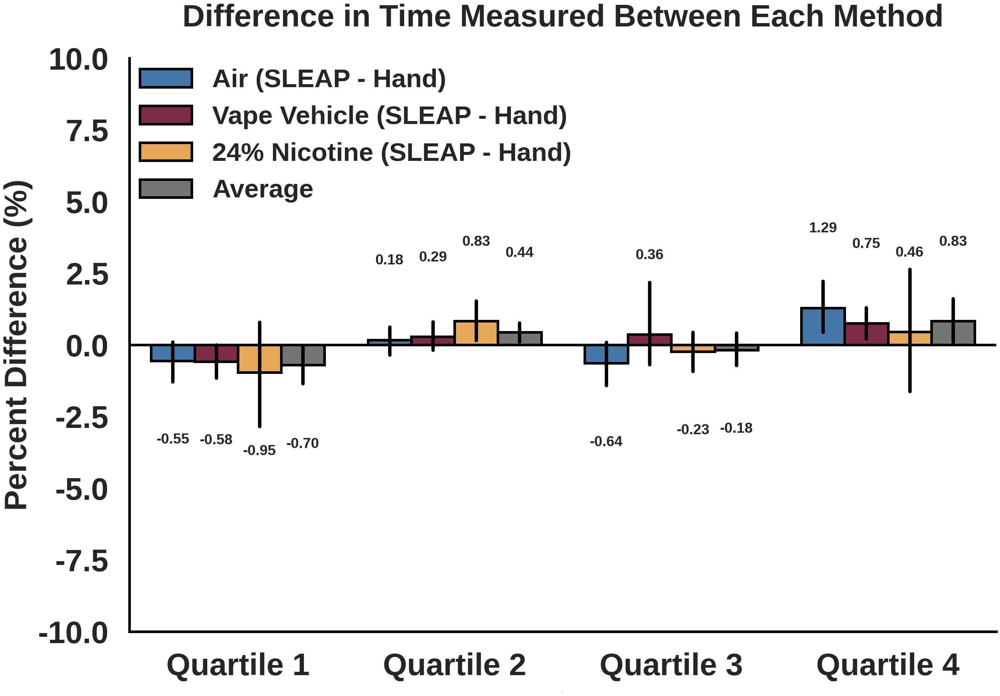

In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Comparisons")
df = get_as_dataframe(sheet).dropna(axis=0, how='all').dropna(axis=1, how='all').drop(columns = ['File', 'HumanTimeQ1', 'HumanTimeQ2', 'HumanTimeQ3', 'HumanTimeQ4',
                                                                               'SleapTimeQ1', 'SleapTimeQ2', 'SleapTimeQ3', 'SleapTimeQ4',
                                                                               'CalcTimeDiffQ1', 'CalcTimeDiffQ2', 'CalcTimeDiffQ3', 'CalcTimeDiffQ4',
                                                                               'SleapDistanceQ1', 'SleapDistanceQ2', 'SleapDistanceQ3', 'SleapDistanceQ4',
                                                                               'TotalDistance', 'CumulativeChange', 'TotalDistanceAsNum'])
df.rename(columns=lambda x: x.replace('TimeDiff', ''), inplace=True)
df1 = df.melt(id_vars=['Day', 'Group'], var_name = 'Quartile', value_name = 'TimeDiff')
df1['Group'] = df1['Group'].replace({0: 'G0', 24: 'G24'})
df1 = df1[pd.to_numeric(df1['TimeDiff'], errors='coerce').notnull()]
df_copy = df1.copy()
df_copy['Group'] = 'Average'
df1 = pd.concat([df1, df_copy], ignore_index=True)
pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
plt.figure(figsize = (3*s,2*s))
palette={'Control':'#3279ba','G0':'#8C1D40',
         'G24':'#ffab40','Average':'#757575'}

hue_order = ['Control', 'G0', 'G24', 'Average']

ax=sns.barplot(x=df1.Quartile,y=df1.TimeDiff,data=df1, hue=df1.Group,palette=palette,
               linewidth=s/2,  hue_order = hue_order, edgecolor='black',errorbar=('ci', 95), err_kws={'color': 'black', 'linewidth': s/1.5})
# sns.stripplot(x=df1.Quartile, y= df1.TimeDiff, data=df1,  dodge=True, palette=palette, hue=df1.Group, hue_order = hue_order,
#                   jitter=True, size=s/2, legend = False)
plt.ylim(-10,10)

# Adjust Legend
if(ax.get_legend() != None):
  legend_labels = ['Air (SLEAP - Hand)','Vape Vehicle (SLEAP - Hand)', '24% Nicotine (SLEAP - Hand)', 'Average']
  leg = plt.legend( loc='upper left', borderaxespad=0, markerscale = 10*s, prop={'size':5*s})
  for t, l in zip(leg.texts, legend_labels):
      t.set_text(l)
      t.set_fontweight('bold')

# Adjust Ticks
ax.set_xticklabels(['','Quartile 1','Quartile 2','Quartile 3', 'Quartile 4'],fontsize=12, fontweight='bold')
ax.axhline(y=0, linewidth=s/2, color='black')
#Adjust Gridlines
sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')
ax.tick_params(pad = 4*s, labelsize = 6*s)
loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
ax.xaxis.set_major_locator(loc)

# Add values above bars
for i in ax.containers:
    ax.bar_label(i, fmt='%.2f', fontsize=s * 2.8, padding=s * 14, fontweight = 'bold')

#Adjust Labels/Titles  Initiation  Response  Collection
plt.ylabel('Percent Difference (%)',fontsize=6*s, labelpad = 1*s, fontweight='bold')
plt.xlabel('Quartile', fontsize=0*s, labelpad = 2*s, fontweight='bold')
plt.title('Difference in Time Measured Between Each Method', fontsize=6*s, fontweight = 'bold', y=1.05)

plt.savefig('Difference.svg', format='svg', bbox_inches='tight')
files.download(f'Difference.svg')

## 🟣 Plot time or distance binned every 5 days in Q4

<ipython-input-34-7740a98db033>:2: FutureWarning: In a future version of pandas all arguments of DataFrame.dropna will be keyword-only.
  df = get_as_dataframe(sheet).dropna(0, 'all').dropna(1, 'all')
<ipython-input-34-7740a98db033>:34: FutureWarning: 

The `errcolor` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'color': 'black'}` instead.

  ax = sns.barplot(x=df1.Bins, y= df1.Time, data=df1, hue=df1.Group, dodge=True, palette=palette, errwidth = s,
<ipython-input-34-7740a98db033>:34: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 10}` instead.

  ax = sns.barplot(x=df1.Bins, y= df1.Time, data=df1, hue=df1.Group, dodge=True, palette=palette, errwidth = s,
<ipython-input-34-7740a98db033>:36: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#000000'` for the same effect.

  sns.stripplot(x=df1.Bins, y= df1.Time, data=df

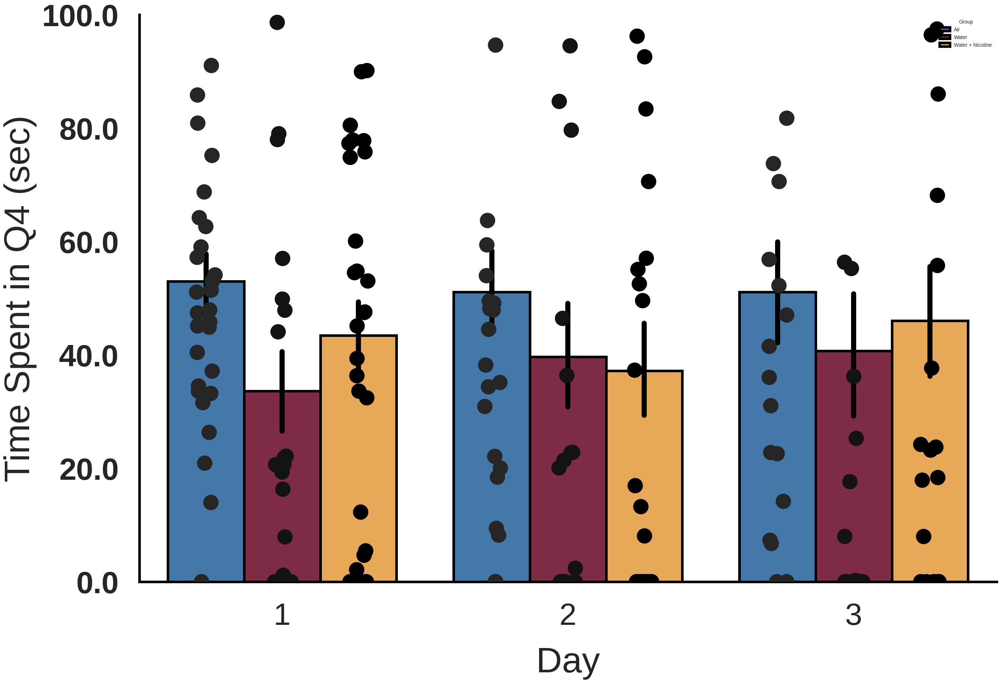

In [ ]:
sheet = gc.open('Roach Data using SLEAP').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(0, 'all').dropna(1, 'all')
df1 = df[df.Group.notna()]
df1 = df1[df1.Day.notna()]
df1 = df1[df1.ScoreType == 'SLEAP']
df1 = df1[df1.Quadrant == 'Q4']
df1["Bins"] = (df1['Day']-1)/5 + 1
df1["Bins"] = df1["Bins"].astype('int')

df1['Distance'] = pd.to_numeric(df1['Distance'], errors='coerce')
df1['Time'] = pd.to_numeric(df1['Time'], errors='coerce')
df1 = df1[df1.Time.notna()]
df1 = df1[df1.Distance.notna()]
df1 = df1[df1.Day.notna()]
df1 = df1[df1.Group.notna()]
df1 = df1[df1.Subject.notna()]
df1['Time'] = pd.to_numeric(df1['Time'], errors='coerce')
df1['Distance'] = pd.to_numeric(df1['Distance'], errors='coerce')
df1['Group'] = df1['Group'].astype(str)
df1['Subject'] = df1['Subject'].astype(str)


# print(df1)

s = 10 #The size of the figure
plt.figure(figsize = (3*s,2*s))
plt.ylim(0,100)
palette={'Air':'#3279ba','Water':'#8C1D40','Water + Nicotine':'#ffab40'}
hue_order = ['Air', 'Water', 'Water + Nicotine']

# ax=sns.lineplot(x=df1.Bins,y=df1.Time,data=df1,hue=df1.Group,palette=palette,
#                 marker = 'o', linewidth=s/2, markersize=2*s, errorbar=('ci', 68))

ax = sns.barplot(x=df1.Bins, y= df1.Time, data=df1, hue=df1.Group, dodge=True, palette=palette, errwidth = s,
                 linewidth=s/2, edgecolor='black', hue_order = hue_order, errorbar=('ci', 69), errcolor = 'black')
sns.stripplot(x=df1.Bins, y= df1.Time, data=df1, hue=df1.Group, dodge=True, color = '#000000',
                 hue_order = hue_order, jitter=True, size=s*3, legend = False)

plt.ylabel('Time Spent in Q4 (sec)',fontsize=7*s,  labelpad = 1*s)
plt.xlabel('Day', fontsize=7*s, labelpad = 3*s)

# Adjust Legend
# if(ax.get_legend() != None):
#   legend_labels = ['Air', 'Vape Vehicle', '24% Nicotine']
#   leg = plt.legend(bbox_to_anchor=(1, 1.4),loc='upper right', borderaxespad=0, markerscale = 10*s, prop={'size':5*s})
#   leg.get_lines()[0].set_linewidth(s)
#   leg.get_lines()[1].set_linewidth(s)
#   leg.get_lines()[2].set_linewidth(s)
#   for t, l in zip(leg.texts, legend_labels):
#       t.set_text(l)

sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
# ax.set_xticklabels(['Day 1-5','Day 6-10','Day 11-14'],fontsize=12, fontweight='bold');
ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold');
ax.tick_params(pad = 4*s, labelsize = 6*s)
loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
ax.xaxis.set_major_locator(loc)